## Feature extraction and fine tuning on different architectures.

Comparison of model architectures, configurations and performance metrics.

Selection of the best-performing architecture

In [ ]:
import os
import gdown
import shutil
import numpy as np
import pandas as pd
import pathlib
import matplotlib.pyplot as plt
from PIL import Image
import cv2
import tensorflow as tf
# import tensorflow_datasets as tfds
from tensorflow import keras
from tensorflow.keras import layers
from keras.models import Model
from tensorflow.keras.utils import save_img, img_to_array, array_to_img, load_img, image_dataset_from_directory
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
# from tensorflow.keras.regularizers import l2
# from tensorflow.keras.metrics import Recall, Precision
from tensorflow.keras.utils import plot_model
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

In [ ]:
IS_COLAB = "google.colab" in str(get_ipython())

if IS_COLAB:
    small_data_dir = pathlib.Path("/content/content/small_subset")
else:
    # import os
    small_data_dir = pathlib.Path(os.getcwd()) / "Source/content/small_subset"

In [ ]:
!pip install wandb

In [ ]:
import wandb
wandb.login()

wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.


<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter:

 ··········


wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: No netrc file found, creating one.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc
wandb: Currently logged in as: syurt (syurt-institution) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


True

In [ ]:
wandb.init(project='melanoma_classification', settings=wandb.Settings(code_dir=None))
from wandb.integration.keras import WandbMetricsLogger, WandbModelCheckpoint

In [ ]:
os.environ["WANDB_MODE"] = "dryrun"
os.environ["WANDB_DIR"] = "/dev/null"
os.environ["WANDB_DATA_DIR"] = "/dev/null"
os.environ["WANDB_CONFIG_DIR"] = "/dev/null"

In [ ]:
def show_dirs_len(path):
  for root, dirs, _ in os.walk(path):
    print(f"{os.path.relpath(root, path)}: {len(os.listdir(root))}")

## Формування робочого датасету

Завантаження джерела

In [ ]:
# https://drive.google.com/file/d/1kkJoL40OW9PfgEMtFkmyHAJWN7BVs_ee/view?usp=sharing
file_id = "1kkJoL40OW9PfgEMtFkmyHAJWN7BVs_ee"
url = f"https://drive.google.com/uc?id={file_id}"
output = "2020_supplemented.zip"

gdown.download(url, output, quiet=False)


Downloading...
From (original): https://drive.google.com/uc?id=1kkJoL40OW9PfgEMtFkmyHAJWN7BVs_ee
From (redirected): https://drive.google.com/uc?id=1kkJoL40OW9PfgEMtFkmyHAJWN7BVs_ee&confirm=t&uuid=314e633e-37f1-406c-97bb-956332d93057
To: /content/2020_supplemented.zip
100%|██████████| 1.59G/1.59G [00:14<00:00, 112MB/s]


'2020_supplemented.zip'

In [ ]:
!unzip -q 2020_supplemented.zip

In [ ]:
show_dirs_len(pathlib.Path("/content/2020_supplemented"))

.: 2
train: 2
train/other: 32112
train/melanoma: 5093
test: 2
test/other: 10638
test/melanoma: 1587


Завантаження додаткових зображень негативного класу (датасет 2019 с темним фоном) - 2963 зображення.

In [ ]:
from google.colab import files
files.upload()

In [ ]:
!unzip -q vignette.zip

In [ ]:
show_dirs_len(pathlib.Path("/content/vignette"))

.: 2963


In [ ]:
# shutil.rmtree("/content/2020_supplemented")
# shutil.rmtree("/content/2019_train_other_split")

In [ ]:
!cp -r /content/vignette/* /content/2020_supplemented/train/other

In [ ]:
show_dirs_len(pathlib.Path("/content/2020_supplemented"))

.: 2
train: 2
train/other: 35075
train/melanoma: 5093
test: 2
test/other: 10638
test/melanoma: 1587


In [ ]:
data_dir = pathlib.Path("/content/2020_supplemented")

Функції для виділення з тренувального набору валідаційного, створення підвибірки датасету потрібного розміру.

In [ ]:
def make_sructured_subset(rate, source_path, dest_path, my_seed, copy=True):

  """create folder the same structure as source
     with of content files"""
  np.random.seed(my_seed)
  for root, dirs, files in os.walk(source_path):
    relative_path = os.path.relpath(root, source_path)
    new_folder = os.path.join(dest_path, relative_path)
    os.makedirs(new_folder, exist_ok=True)
    if files:
      num_files = int(len(files)*rate)
      files_to_copy = np.random.choice(files, num_files, replace=False)

      for filename in files_to_copy:
        src_file = os.path.join(root, filename)
        dest_file = os.path.join(new_folder, filename)
        if copy:
          shutil.copyfile(src_file, dest_file)
        else:
          shutil.move(src_file, dest_file)

In [ ]:
def make_balanced_sructured_subset(source_path, dest_path, my_seed, rates_per_class, copy=True):

  """create folder the same structure as source
     with part of content files, picked using different rate for selected folder:
      rate*k"""
  np.random.seed(my_seed)
  for root, dirs, files in os.walk(source_path):
    relative_path = os.path.relpath(root, source_path)
    class_name = os.path.basename(relative_path)
    if class_name in rates_per_class:
       rate = rates_per_class[class_name]
    else:
      rate = 0.2
    new_folder = os.path.join(dest_path, relative_path)
    os.makedirs(new_folder, exist_ok=True)
    if files:
      num_files = int(len(files)*rate)
      files_to_copy = np.random.choice(files, num_files, replace=False)

      for filename in files_to_copy:
        src_file = os.path.join(root, filename)
        dest_file = os.path.join(new_folder, filename)
        if copy:
          shutil.copyfile(src_file, dest_file)
        else:
          shutil.move(src_file, dest_file)

In [ ]:
def make_custom_sructured_subset(source_path, dest_path, my_seed, rates_per_ds, copy=True):

  """create folder the same structure as source
     with % of source folder files, randomly picked
     using different rate for each ds"""
  np.random.seed(my_seed)
  for root, dirs, files in os.walk(source_path):
    relative_path = os.path.relpath(root, source_path)
    new_folder = os.path.join(dest_path, relative_path)
    os.makedirs(new_folder, exist_ok=True)
    if files:
      for ds in rates_per_ds.keys():
        if ds in new_folder.split(os.sep):
          rate = rates_per_ds[ds]
          break
      num_files = int(len(files)*rate)
      files_to_copy = np.random.choice(files, num_files, replace=False)

      for filename in files_to_copy:
        src_file = os.path.join(root, filename)
        dest_file = os.path.join(new_folder, filename)
        if copy:
          shutil.copyfile(src_file, dest_file)
        else:
          shutil.move(src_file, dest_file)

In [ ]:
# select in validation directory equal size of classes
val_dir = data_dir / "validation"
train_dir = data_dir / "train"
num_melanoma = len(os.listdir(os.path.join(train_dir, "melanoma")))
num_other = len(os.listdir(os.path.join(train_dir, "other")))
k = num_melanoma/num_other if num_other > 0 else 1
print(k)
rates_per_class = {
    "melanoma": 0.2,
    "other": 0.2*k
}
make_balanced_sructured_subset(train_dir, val_dir, 40, rates_per_class, copy=False)

0.1452031361368496


In [ ]:
show_dirs_len(data_dir)

.: 3
train: 2
train/other: 34057
train/melanoma: 4075
validation: 2
validation/other: 1018
validation/melanoma: 1018
test: 2
test/other: 10638
test/melanoma: 1587


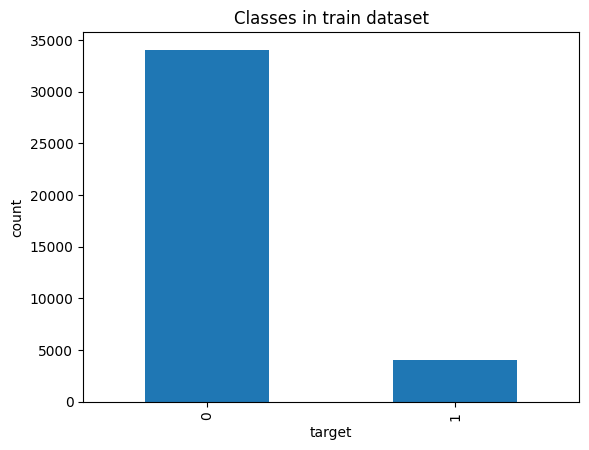

In [ ]:
tmp_df1 = pd.DataFrame({"image_name": os.listdir(data_dir / "train/melanoma"), "target": 1})
tmp_df2 = pd.DataFrame({"image_name": os.listdir(data_dir / "train/other"), "target": 0})
tmp_df_comb = pd.concat([tmp_df1, tmp_df2], ignore_index=True)
tmp_df_comb.target.value_counts().plot(kind='bar')
plt.title('Classes in train dataset')
plt.xlabel('target')
plt.ylabel('count')
plt.show()

### Функції для аугментації

In [ ]:
def augment_and_save(img_path, data_augmentation, num_aug, save=True, output_dir=None, add_func=None):
  aug_images_set =[]
  img = load_img(img_path) #завантажує зображення як PIL
  img_arr = img_to_array(img) #конвертує у NumPy
  img_arr = np.expand_dims(img_arr, axis=0)  # додати розмірність - batch
  for i in range(num_aug):
    augmented_img_arr = data_augmentation(img_arr, training=True)
    # augmented_img = keras.utils.array_to_img(augmented_img_arr[0])
    augmented_img = array_to_img(augmented_img_arr[0])   #first in batch
    if add_func is not None:
      augmented_img = add_func(augmented_img)
    aug_images_set.append(augmented_img)
    if save:
      os.makedirs(output_dir, exist_ok=True)
      img_name = os.path.basename(img_path)
      output_path = os.path.join(output_dir, f"{os.path.splitext(img_name)[0]}_aug_{i}.jpg")
      save_img(output_path, augmented_img)
  return aug_images_set

def run_augmentation(data_augmentation, input_dir, output_dir, num_aug, add_func=None):
  for img_name in os.listdir(input_dir):
    if img_name.endswith((".png", ".jpg", ".jpeg")):
      img_path = os.path.join(input_dir, img_name)
      augment_and_save(img_path, data_augmentation, num_aug, save=True, output_dir=output_dir, add_func=add_func)

def run_selective_augmentation(data_augmentation, input_dir, output_dir, num_aug, ratio=0.3, my_seed=42, add_func=None):
  """augmentation of subset"""
  np.random.seed(my_seed)
  images = os.listdir(input_dir)
  images_to_augm = np.random.choice(images, int(len(images)*ratio), replace=False)
  for img_name in images_to_augm:
    if img_name.endswith((".png", ".jpg", ".jpeg")):
      img_path = os.path.join(input_dir, img_name)
      augment_and_save(img_path, data_augmentation, num_aug, save=True, output_dir=output_dir, add_func=add_func)

In [ ]:
def add_files(source_dir, dest_dir):
  os.makedirs(dest_dir, exist_ok=True)
  for file_name in os.listdir(source_dir):
    source_file = os.path.join(source_dir, file_name)
    if os.path.isfile(source_file):
      destination_file = os.path.join(dest_dir, file_name)
      shutil.copyfile(source_file, destination_file)

## Додавання чорного фону

In [ ]:
def add_vignette(image_path, intensity=0.9, window_radius_ratio=1):
    """
    Додати вин'єтку (чорну рамку) навколо зображення.
    :param intensity: інтенсивність затемнення.
    """
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError("Image is not loaded")
    h, w = image.shape[:2]
    y, x = np.mgrid[0:h, 0:w]
    cx, cy = w // 2, h // 2
    # Радіальна градієнтна маска
    window_radius = int(min(cx, cy)*window_radius_ratio)
    distance = np.sqrt((x - cx)**2 + (y - cy)**2)
    mask = np.ones((h, w), dtype=np.float32)
    mask[distance > window_radius] = 1 - intensity
    mask = cv2.merge([mask, mask, mask]).astype(np.float32)  # Для 3-х каналів

    vignette_image = (image * mask).astype(np.uint8)
    # масив NumPy, який містить зображення в форматі RGB
    vignette_image = cv2.cvtColor(vignette_image, cv2.COLOR_BGR2RGB)
    # pil_vignette_image = Image.fromarray(vignette_image) #перетворити у PIL
    return vignette_image

In [ ]:
class VignetteLayer(layers.Layer):
    def __init__(self, intensity=(0.4, 1), window_radius_ratio=(0.85, 1),**kwargs):
        super().__init__(**kwargs)

        self.intensity_range = intensity
        self.window_radius_range = window_radius_ratio
        # self.blur_kernel_size = blur_kernel_size  # (odd number, the less - the sharper)

    def call(self, image):

        input_shape = tf.shape(image)
        batch_size = input_shape[0]
        h = tf.cast(input_shape[1], tf.int32)
        w = tf.cast(input_shape[2], tf.int32)

        intensities = tf.random.uniform((batch_size,), self.intensity_range[0], self.intensity_range[1])
        window_radius_ratios = tf.random.uniform((batch_size,), self.window_radius_range[0], self.window_radius_range[1])

        # h, w = image_np.shape[:2]
        y, x = tf.meshgrid(tf.range(h), tf.range(w), indexing='ij')
        y, x = tf.cast(y, tf.float32), tf.cast(x, tf.float32)
        cx, cy = tf.cast(w / 2, tf.float32), tf.cast(h / 2, tf.float32)
        distance = tf.sqrt((x - cx)**2 + (y - cy)**2)

        masks = []
        for i in range(batch_size):
          window_radius_ratio = window_radius_ratios[i]
          intensity = intensities[i]

          window_radius = tf.minimum(cx, cy) * window_radius_ratio

          mask = tf.ones((h, w), dtype=tf.float32)
          mask = tf.where(distance > window_radius, 1 - intensity, mask)

          mask = tf.expand_dims(mask, axis=-1)  # channels axis (h, w, 1)
          mask = tf.image.resize(mask, [h, w], method="gaussian")  # blur by resize
          masks.append(mask)

        mask_tensor = tf.stack(masks, axis=0)  # (batch_size, h, w, 1)

        vignette_image = image * mask_tensor

        return vignette_image

    def compute_output_shape(self, input_shape):
      return input_shape


In [ ]:
data_augmentation_masked = keras.Sequential(
     [
      # layers.RandomFlip(mode="horizontal_and_vertical"),
      layers.RandomRotation(0.3),
      # layers.RandomShear(x_factor=0.2, y_factor=0.2, fill_mode="nearest"),
      layers.RandomColorJitter(
          value_range=(0, 255),
          brightness_factor=0.1,
          contrast_factor=0.1,
          saturation_factor=(0.46, 0.54),
          hue_factor=0.05),
      VignetteLayer(intensity=(0.5, 1), window_radius_ratio=(0.8, 1))
    ]
)

In [ ]:
# rate = 0.187
# source_path = pathlib.Path("/content/2019_train_other_split/not_vignette")
# dest_path = pathlib.Path("/content/2019_train_other_selection")
# my_seed = 42
# make_sructured_subset(rate, source_path, dest_path, my_seed, copy=True)

In [ ]:
# show_dirs_len(dest_path)

.: 3329


In [ ]:
input_dir = pathlib.Path("/content/2019_train_other_split/not_vignette")
output_dir = pathlib.Path("/content/augmented")
np.random.seed(42)

### Тестування методів аугментації

З використанням шару VignetteLayer

In [ ]:
augm_example = np.random.choice(os.listdir(input_dir), 3)[2]
augm_example_path = os.path.join(input_dir, augm_example)
augm_example_set = augment_and_save(augm_example_path, data_augmentation_masked, 5, save=False)
augm_example_set = [Image.open(augm_example_path)] + augm_example_set

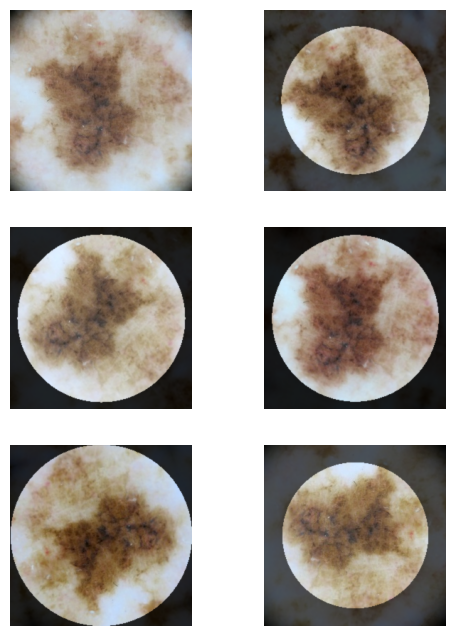

In [ ]:
plt.figure(figsize=(6, 8))
for i, image in enumerate(augm_example_set):
  ax = plt.subplot(3, 2, i + 1)
  plt.imshow(img_to_array(image).astype("uint8"))
  plt.axis("off")


З використанням функції add_vignette

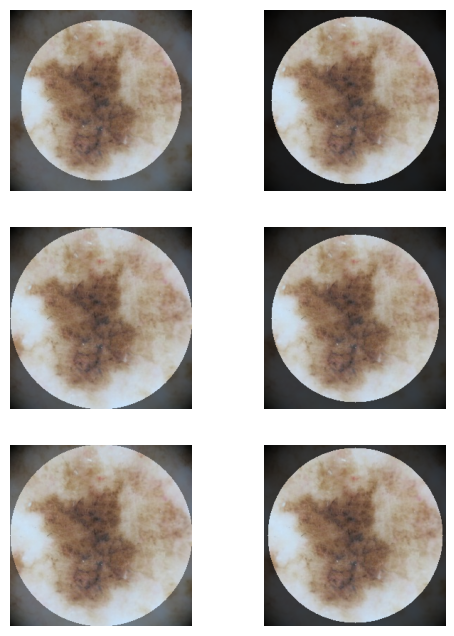

In [ ]:
image = cv2.imread(augm_example_path)
augm_example_set = []
for _ in range(6):
  window_radius_ratio = np.random.choice(np.linspace(0.85, 1, 5), 1)[0] # конверація типу з 1d масиву у число
  intensity = np.random.choice(np.linspace(0.4, 1, 10), 1)[0]
  vignetted_image = add_vignette(augm_example_path, intensity=intensity, window_radius_ratio=window_radius_ratio)
  augm_example_set.append(vignetted_image)

plt.figure(figsize=(6, 8))
for i, image in enumerate(augm_example_set):
  ax = plt.subplot(3, 2, i + 1)
  plt.imshow(img_to_array(image).astype("uint8"))
  plt.axis("off")

Для додавання фону обрано використання шару VignetteLayer

Вибрати частину зображень з тренувального набору 2019 без чорного фону ~ 3337 шт. (18,7%), зробити аугментацію з накладанням чорного фону та додати до тренувального набору.

In [ ]:
run_selective_augmentation(data_augmentation_masked, input_dir, output_dir, 1, ratio=0.187, my_seed=42)

In [ ]:
show_dirs_len(output_dir)

.: 3329


Аугментація з чорним фоном виконана для 3329 зображень.

In [ ]:
# додати аугментовані файли у train/other
dest_dir = pathlib.Path("/content/2020_supplemented/train/other")
add_files(output_dir, dest_dir)

In [ ]:
show_dirs_len(data_dir)

.: 3
validation: 2
validation/melanoma: 1018
validation/other: 1018
train: 2
train/melanoma: 4075
train/other: 37386
test: 2
test/melanoma: 1587
test/other: 10638


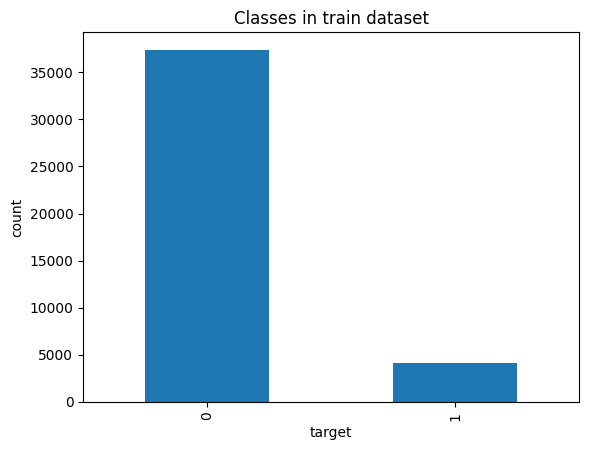

In [ ]:
tmp_df1 = pd.DataFrame({"image_name": os.listdir(data_dir / "train/melanoma"), "target": 1})
tmp_df2 = pd.DataFrame({"image_name": os.listdir(data_dir / "train/other"), "target": 0})
tmp_df_comb = pd.concat([tmp_df1, tmp_df2], ignore_index=True)
tmp_df_comb.target.value_counts().plot(kind='bar')
plt.title('Classes in train dataset')
plt.xlabel('target')
plt.ylabel('count')
plt.show()

In [ ]:
# зберегти за потреби аугментовані зображення
!zip -q -r 2019_train_other_augmmasked.zip . -i /augmented/*
from google.colab import files
files.download("2019_train_other_augmmasked.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# зберегти за потреби доповнений датасет
!zip -q -r 2020_suplemented2.zip . -i /2020_supplemented/*
from google.colab import files
files.download("2020_suplemented2.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Створення вибірки з основного датасету для навчання на меншій кількості даних

In [ ]:
# select different proportion for train, valid and test datasets in small subset
subset_path = pathlib.Path("/content/small_subset")
rates_per_ds = {
    "train": 0.3,
    "validation": 1.0,
    "test": 0.7,
}
make_custom_sructured_subset(data_dir, subset_path, 10, rates_per_ds)

In [ ]:
show_dirs_len(subset_path)

.: 3
train: 2
train/other: 10217
train/melanoma: 1222
validation: 2
validation/other: 1018
validation/melanoma: 1018
test: 2
test/other: 7446
test/melanoma: 1110


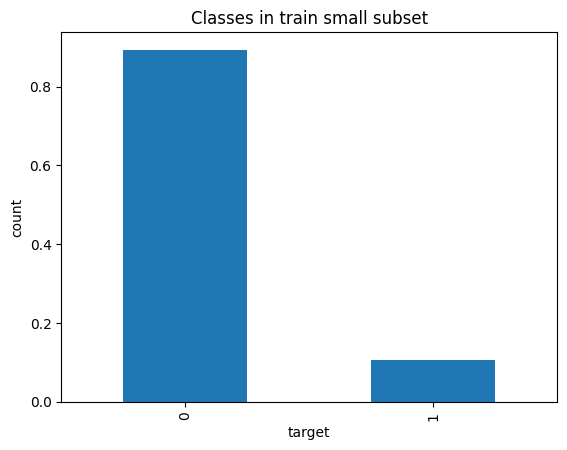

In [ ]:
tmp_df1 = pd.DataFrame({"image_name": os.listdir(subset_path / "train/melanoma"), "target": 1})
tmp_df2 = pd.DataFrame({"image_name": os.listdir(subset_path / "train/other"), "target": 0})
tmp_df_comb = pd.concat([tmp_df1, tmp_df2], ignore_index=True)
tmp_df_comb.target.value_counts(normalize=True).plot(kind='bar')
plt.title('Classes in train small subset')
plt.xlabel('target')
plt.ylabel('count')
plt.show()

## Аугментація цільового класу для збалансування набору

In [ ]:
data_augmentation = keras.Sequential(
    [ layers.RandomFlip(mode="horizontal_and_vertical"),
      layers.RandomRotation(0.5),
      layers.RandomZoom(0.3),
      layers.RandomShear(x_factor=0.2, y_factor=0.2, fill_mode="nearest"),
      # layers.MixUp(alpha=0.2),
      layers.RandomColorJitter(
          value_range=(0, 255),
          brightness_factor=0.1,
          contrast_factor=0.1,
          saturation_factor=(0.46, 0.54),
          hue_factor=0.05)
    ]
)

In [ ]:
# shutil.rmtree("/content/augmented")

In [ ]:
input_dir = pathlib.Path("/content/small_subset/train/melanoma")
output_dir = pathlib.Path("/content/augmented")

Аугментація зображень з тренувального набору (вибірка) для класу "меланома".

In [ ]:
np.random.seed(42)
augm_example = np.random.choice(os.listdir(input_dir), 1)[0]
augm_example_path = os.path.join(input_dir, augm_example)
augm_example_set = augment_and_save(augm_example_path, data_augmentation, 5, save=False)
augm_example_set = [Image.open(augm_example_path)] + augm_example_set

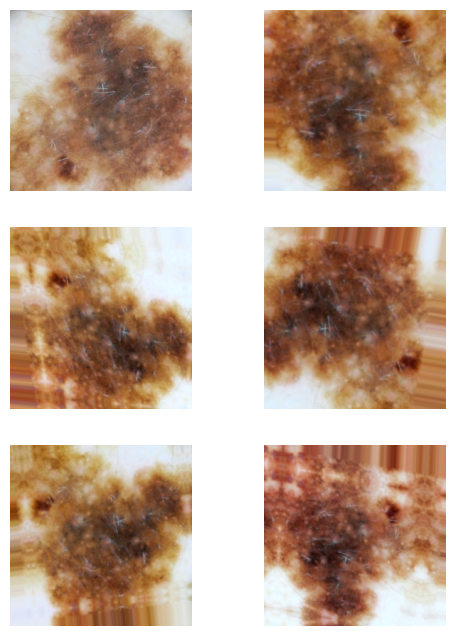

In [ ]:
plt.figure(figsize=(6, 8))
for i, image in enumerate(augm_example_set):
  ax = plt.subplot(3, 2, i + 1)
  plt.imshow(img_to_array(image).astype("uint8"))
  plt.axis("off")

In [ ]:
run_augmentation(data_augmentation, input_dir, output_dir, 4)

In [ ]:
show_dirs_len(output_dir)

.: 4888


In [ ]:
# зберегти за потреби аугментовані зображення
!zip -q -r 2020_train_melanoma_augmented_sub4.zip . -i /augmented/*
from google.colab import files
files.download("2020_train_melanoma_augmented_sub4.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# зберегти за потреби вибірку без аугментації
!zip -q -r small_subset.zip content/small_subset/
from google.colab import files
files.download("small_subset.zip")


zip error: Nothing to do! (try: zip -q -r 2020_small_subset.zip . -i ./content/small_subset/)


In [ ]:
# додати аугментовані файли у вибірку
add_files(output_dir, input_dir)

In [ ]:
show_dirs_len(input_dir)

.: 6110


In [ ]:
show_dirs_len(subset_path)

.: 3
train: 2
train/other: 10217
train/melanoma: 6110
validation: 2
validation/other: 1018
validation/melanoma: 1018
test: 2
test/other: 7446
test/melanoma: 1110


In [ ]:
# зберегти вибірку з аугментацією цільового класу
!zip -q -r small_subset_with_augm4m.zip /content/small_subset
from google.colab import files
files.download("small_subset_with_augm4m.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

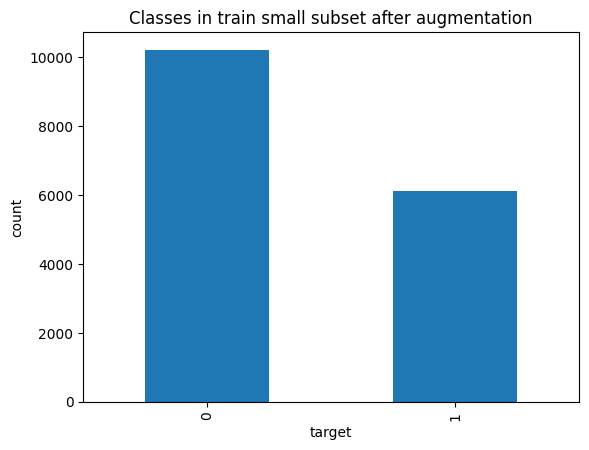

In [ ]:
tmp_df1 = pd.DataFrame({"image_name": os.listdir(subset_path / "train/melanoma"), "target": 1})
tmp_df2 = pd.DataFrame({"image_name": os.listdir(subset_path / "train/other"), "target": 0})
tmp_df_comb = pd.concat([tmp_df1, tmp_df2], ignore_index=True)
tmp_df_comb.target.value_counts().plot(kind='bar')
plt.title('Classes in train small subset after augmentation')
plt.xlabel('target')
plt.ylabel('count')
plt.show()

## Завантаження даних для навчання

In [ ]:
# датасет з аугментацією 1:4
# https://drive.google.com/file/d/1jrmdtmAGgALX48gEmvBEMzMQL1aMX7MS/view?usp=sharing
file_id = "1jrmdtmAGgALX48gEmvBEMzMQL1aMX7MS"
url = f"https://drive.google.com/uc?id={file_id}"
output = "small_subset_with_augm4.zip"

gdown.download(url, output, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?id=1jrmdtmAGgALX48gEmvBEMzMQL1aMX7MS
From (redirected): https://drive.google.com/uc?id=1jrmdtmAGgALX48gEmvBEMzMQL1aMX7MS&confirm=t&uuid=8974cfc2-dbb2-4771-81b4-59fccad2de8f
To: /content/small_subset_with_augm4.zip
100%|██████████| 899M/899M [00:17<00:00, 51.8MB/s]


'small_subset_with_augm4.zip'

In [ ]:
!unzip -q small_subset_with_augm4.zip

In [ ]:
small_data_dir = pathlib.Path("/content/content/small_subset")
show_dirs_len(small_data_dir)

.: 3
test: 2
test/other: 7446
test/melanoma: 1110
validation: 2
validation/other: 1018
validation/melanoma: 1018
train: 2
train/other: 9328
train/melanoma: 6110


In [ ]:
# small_data_dir =  pathlib.Path("/Source/content/small_subset")
# show_dirs_len(small_data_dir)

.: 3
test: 2
test\melanoma: 1110
test\other: 7446
train: 2
train\melanoma: 6110
train\other: 9328
validation: 2
validation\melanoma: 1018
validation\other: 1018


In [ ]:
# small_data_dir

WindowsPath('C:/Users/11/Desktop/1UNIVER/Diploma/Source/content/small_subset')

## Визначення параметрів, функцій для побудови моделі

In [ ]:
def generate_model_version_name():

  from datetime import datetime

  now = datetime.now()
  month_day = now.strftime("%m-%d")  # Формат: ММ-ДД
  hours = now.strftime("%H")  # Формат: ЧЧ, тільки години
  return month_day + "-" + hours

In [ ]:
# при дисбалансі класів
def binary_class_weights(dataset):
  count_1 = 0
  count_0 = 0
  for items, labels in dataset:
    labels = labels.numpy()
    count_1 += np.sum(labels==1)
    count_0 += np.sum(labels==0)
  weight_1 = (1/count_1) * ((count_1+count_0)/2.0)
  weight_0 = (1/count_0) * ((count_1+count_0)/2.0)
  return (weight_0, weight_1)

def initial_bias_calc(dataset):
  count_1 = 0
  count_0 = 0
  for items, labels in dataset:
    labels = labels.numpy()
    count_1 += np.sum(labels==1)
    count_0 += np.sum(labels==0)
  weight_1 = (1/count_1) * ((count_1+count_0)/2.0)
  weight_0 = (1/count_0) * ((count_1+count_0)/2.0)
  return np.log([count_1/count_0])


In [ ]:
# при дисбалансі класів при відомій кількості екземплярів кожного класу
def binary_class_weights_2(count_1, count_0):
  weight_1 = (1/count_1) * ((count_1+count_0)/2.0)
  weight_0 = (1/count_0) * ((count_1+count_0)/2.0)
  return (weight_0, weight_1)

def initial_bias_calc_2(count_1, count_0):
  weight_1 = (1/count_1) * ((count_1+count_0)/2.0)
  weight_0 = (1/count_0) * ((count_1+count_0)/2.0)
  return np.log(count_1/count_0)

In [ ]:
# логування
import csv
from tensorflow.keras.callbacks import Callback

# зібрати під час навчання метрики
class MetricsLogger(Callback):
    def __init__(self, filepath):
        super().__init__()
        self.filepath = filepath
        self.metrics = None
        # create file on init
        with open(self.filepath, mode='w', newline='') as f:
            writer = csv.writer(f)
            writer.writerow([''])
    # method Callbak class
    def on_epoch_end(self, epoch, logs=None):
        logs = logs or {}
        # get logs keys
        if self.metrics is None:
          self.metrics = list(logs.keys())
            # add metrics header to csv
          with open(self.filepath, mode='a', newline='') as f:
              writer = csv.writer(f)
              writer.writerow(['epoch'] + self.metrics)
        with open(self.filepath, mode='a', newline='') as f:
            writer = csv.writer(f)
            writer.writerow([epoch] + [logs[m] for m in self.metrics])

In [ ]:
# візуалізація
def plot_scores (df, model_name, metrics_list):
  n = len(metrics_list)
  fig = plt.figure(figsize=(16, int(np.ceil(n/3)*4) ))
  fig.suptitle(f'{model_name}')
  for i, metric in enumerate(metrics_list):
    ax = plt.subplot(int(np.ceil(n/3)), 3, i + 1)
    ax.plot(df.index+1, df[metric], label=metric)
    ax.plot(df.index+1, df["val_" + metric], label="val_" + metric)
    ax.legend(loc='lower right')
    ax.grid(True)
  fig2 = plt.figure(figsize=(8, 6))
  for i, metric in enumerate(metrics_list):
    plt.plot(df.index+1, df[metric], label=metric)
    plt.plot(df.index+1, df["val_" + metric], label="val_" + metric)
  plt.legend(loc='lower right')
  plt.show();

def plot_loss(df, model_name):
  fig = plt.figure(figsize=(8, 6))
  fig.suptitle(f'{model_name + " loss"}')
  plt.plot(df.index+1, df['loss'], label='train loss')
  plt.plot(df.index+1, df["val_loss"], label="validation loss")
  plt.legend(loc='lower right')
  plt.grid(True)
  plt.show();

In [ ]:
def plot_confusion_matrix(labels, predictions, threshold=0.5):
  cm = confusion_matrix(labels, predictions > threshold)
  disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["other", "melanoma"])
  disp.plot(cmap=plt.cm.Blues)
  plt.xlabel("Predictions")
  plt.ylabel("Actual")
  plt.title('Confusion matrix')
  plt.show()

In [ ]:
def fbeta_metric(precision, recall, beta=2.0):
  return precision * recall * (1+beta**2)/( (beta**2) * precision + recall)

In [ ]:
# IM_SIZE = 256
BATCH_SIZE = 32
METRICS = [
      keras.metrics.BinaryAccuracy(name='accuracy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'),
      keras.metrics.AUC(name='auc'),
      keras.metrics.AUC(name='prc', curve='PR') # precision-recall curve
]
VERSION = generate_model_version_name()
# MODEL_NAME = f"Basic_model_{VERSION}"
LEARNING_RATE = 1e-4

In [ ]:
VERSION

'04-07-19'

In [ ]:
train_ds = tf.keras.utils.image_dataset_from_directory(
  small_data_dir / "train",
  class_names=["other", "melanoma"],
  seed=123,
  # image_size=(IM_SIZE, IM_SIZE),
  shuffle=True,
  batch_size=BATCH_SIZE)

val_ds = tf.keras.utils.image_dataset_from_directory(
  small_data_dir / "validation",
  class_names=["other", "melanoma"],
  seed=123,
  # image_size=(IM_SIZE, IM_SIZE),
  batch_size=BATCH_SIZE)

test_ds = tf.keras.utils.image_dataset_from_directory(
  small_data_dir / "test",
  class_names=["other", "melanoma"],
  seed=123,
  # image_size=(IM_SIZE, IM_SIZE),
  batch_size=BATCH_SIZE)

Found 15438 files belonging to 2 classes.
Found 2036 files belonging to 2 classes.
Found 8556 files belonging to 2 classes.


### Візуалізація датасету

In [ ]:
class_names = train_ds.class_names
print(class_names)

['other', 'melanoma']


In [ ]:
print(train_ds)
print(val_ds)
print(test_ds)

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>
<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>
<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>


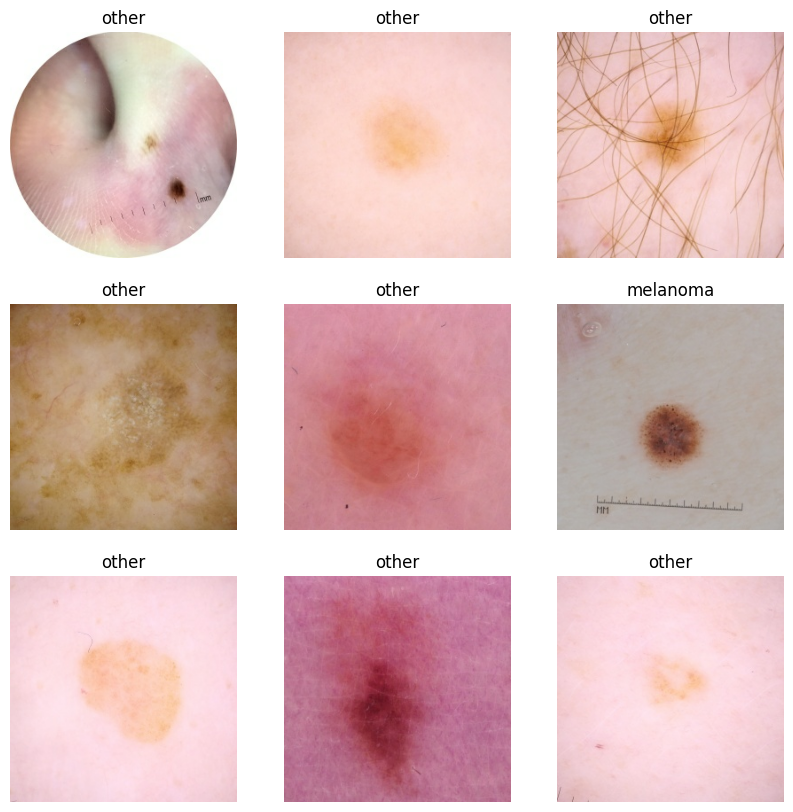

In [ ]:
plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

## Створення моделі, передобробка датасету, навчання, оцінка

In [ ]:
# Configure the dataset for performance
train_ds = train_ds.shuffle(64).prefetch(buffer_size=tf.data.AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size=tf.data.AUTOTUNE)
test_ds = test_ds.prefetch(buffer_size=tf.data.AUTOTUNE)

### при дисбалансі класів

In [ ]:
count_1 = len(os.listdir(small_data_dir / "train/melanoma"))
count_0 = len(os.listdir(small_data_dir / "train/other"))

In [ ]:
# weight_0, weight_1 = binary_class_weights(train_ds)
weight_0, weight_1 = binary_class_weights_2(count_1, count_0)

class_weights = {0: weight_0, 1: weight_1}

print(f'Weight for class 0: {weight_0:.2f}')
print(f'Weight for class 1: {weight_1:.2f}')

Weight for class 0: 0.83
Weight for class 1: 1.26


In [ ]:
# initial_bias = initial_bias_calc(train_ds)
initial_bias = initial_bias_calc_2(count_1, count_0)
print(f'initial_bias: {initial_bias}')

initial_bias: -0.4230938564246326


### Модель

In [ ]:
# створення та компіляція моделі з заданим bias для останнього шару
def make_model(learning_rate=1e-3, metrics=METRICS, model=None, output_bias=None):
  model.compile(
      optimizer=keras.optimizers.Adam(learning_rate=learning_rate),
      loss=keras.losses.BinaryCrossentropy(),
      metrics=metrics)
  if output_bias is not None:
    model.layers[-1].bias.assign([output_bias])
  return model

In [ ]:
MODEL_NAMES = [f"MobileNetV2_{VERSION}",
              f"Xception_{VERSION}",
              f"ResNet50V2_{VERSION}",
              f"InceptionV3_{VERSION}",
               f"ConvNeXtTiny_{VERSION}",
               f"DenseNet121_{VERSION}",
               f"NASNetMobile_{VERSION}",
               f"EfficientNetV2B0_{VERSION}"]

In [ ]:
# ! Перезапускати
model_index = 5
MODEL_NAME = MODEL_NAMES[model_index]

In [ ]:
MODEL_NAME

'EfficientNetV2B0_04-07-19'

In [ ]:
if model_index == 0:
  from keras.applications.mobilenet_v2 import MobileNetV2, preprocess_input
  IM_SIZE = 256       #224
  base_model = MobileNetV2(
    weights="imagenet",
    input_shape=(IM_SIZE, IM_SIZE, 3),
    include_top=False)

if model_index == 1:
  from keras.applications.xception import Xception, preprocess_input
  IM_SIZE = 256   #229
  base_model = Xception(
    weights="imagenet",
    input_shape=(IM_SIZE, IM_SIZE, 3),
    include_top=False)

if model_index == 2:
  from keras.applications.resnet_v2 import ResNet50V2, preprocess_input
  IM_SIZE = 256   #224
  base_model = ResNet50V2(
    weights="imagenet",
    input_shape=(IM_SIZE, IM_SIZE, 3),
    include_top=False)

if model_index == 3:
  from keras.applications.inception_v3 import InceptionV3, preprocess_input
  IM_SIZE = 256   #229
  base_model = InceptionV3(
    weights="imagenet",
    input_shape=(IM_SIZE, IM_SIZE, 3),
    include_top=False)

if model_index == 4:
  from keras.applications.convnext import ConvNeXtTiny, preprocess_input
  IM_SIZE = 256
  base_model = ConvNeXtTiny(
    weights="imagenet",
    input_shape=(IM_SIZE, IM_SIZE, 3),
    include_top=False)

if model_index == 5:
  from keras.applications.densenet import DenseNet121, preprocess_input
  IM_SIZE = 256   #224
  base_model = DenseNet121(
    weights="imagenet",
    input_shape=(IM_SIZE, IM_SIZE, 3),
    include_top=False)

if model_index == 6:
  from keras.applications.nasnet import NASNetMobile, preprocess_input
  IM_SIZE = 256    #224
  base_model = NASNetMobile(
    weights="imagenet",
    input_shape=(IM_SIZE, IM_SIZE, 3),
    include_top=False)

if model_index == 7:
  from keras.applications.efficientnet_v2 import EfficientNetV2B0, preprocess_input
  IM_SIZE = 256
  base_model = EfficientNetV2B0(
    weights="imagenet",
    input_shape=(IM_SIZE, IM_SIZE, 3),
    include_top=False)

print(base_model.output_shape)

# preprocess for fine_tuning:
def preprocess(image, label):
  image = preprocess_input(image)
  return image, label

29084464/29084464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
(None, 8, 8, 1024)


In [ ]:
# заморозити шари базової моделі
base_model.trainable = False

In [ ]:
# train_ds = train_ds.map(preprocess)
# val_ds = val_ds.map(preprocess)
# test_ds = test_ds.map(preprocess)

In [ ]:
# модель
inputs = keras.Input(shape=(IM_SIZE, IM_SIZE, 3))
preprocessed = layers.Lambda(preprocess_input)(inputs)
x = base_model(preprocessed, training=False)  #to keep batchnorm layers in inference mode, when unfreeze the base model for fine-tuning
x = keras.layers.GlobalAveragePooling2D()(x)
x = keras.layers.Dropout(0.5)(x)
x = keras.layers.Dense(128, activation='relu', name="full_con1")(x)
outputs = keras.layers.Dense(1, activation='sigmoid', name="pred")(x)
model = keras.Model(inputs, outputs)

# models selection

### MobileNetV2

### Feature extraction

In [ ]:
labels = ['tl-', 'ft-']
label = labels[0]

In [ ]:
MODEL_NAME

'MobileNetV2_04-05-14'

In [ ]:
# створення та компіляція transfer learning моделі
ft_model = make_model(metrics=METRICS, model=model, output_bias=initial_bias)
model.summary(show_trainable=True)

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Layer (type)                        ┃ Output Shape                 ┃       Param # ┃ Traina… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━┩
│ input_layer_1 (InputLayer)          │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ lambda (Lambda)                     │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ mobilenetv2_1.00_224 (Functional)   │ (None, 8, 8, 1280)           │     2,257,984 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ global_average_pooling2d            │ (None, 1280)                 │             0 │    -    │
│ (GlobalAveragePooling2D)            │                              │               │         │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ dropout (Dropout)                   │ (None, 1280)                 │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ full_con1 (Dense)                   │ (None, 128)                  │       163,968 │    Y    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ pred (Dense)                        │ (None, 1)                    │           129 │    Y    │
└─────────────────────────────────────┴──────────────────────────────┴───────────────┴─────────┘

 Total params: 2,422,081 (9.24 MB)

 Trainable params: 164,097 (641.00 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

In [ ]:
# створити логгер
metrics_logger = MetricsLogger(filepath=f"metrics_logs_{label}{MODEL_NAME}.csv")

In [ ]:
callbacks_list = [EarlyStopping(monitor='val_accuracy', patience=6),
                  ModelCheckpoint(f'small-{label}{MODEL_NAME}.keras', monitor='val_loss', save_best_only=True),
                  metrics_logger,
                  # WandbMetricsLogger(),
                  # WandbModelCheckpoint(filepath=f"small-{label}{MODEL_NAME}_wandb.keras", monitor="val_loss")
]

epochs=20

In [ ]:
# MobileNetV2
history = ft_model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs,
  callbacks=callbacks_list,
  class_weight=class_weights
)

Epoch 1/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 47s 69ms/step - accuracy: 0.9145 - auc: 0.9650 - fn: 281.1467 - fp: 315.3099 - loss: 0.2248 - prc: 0.9592 - precision: 0.8853 - recall: 0.8972 - tn: 4371.0122 - tp: 2790.8286 - val_accuracy: 0.8006 - val_auc: 0.9423 - val_fn: 389.0000 - val_fp: 17.0000 - val_loss: 0.4803 - val_prc: 0.9485 - val_precision: 0.9737 - val_recall: 0.6179 - val_tn: 1001.0000 - val_tp: 629.0000
Epoch 2/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 21s 40ms/step - accuracy: 0.9473 - auc: 0.9837 - fn: 222.8017 - fp: 194.1963 - loss: 0.1506 - prc: 0.9810 - precision: 0.9376 - recall: 0.9282 - tn: 4490.8613 - tp: 2851.2190 - val_accuracy: 0.8531 - val_auc: 0.9490 - val_fn: 251.0000 - val_fp: 48.0000 - val_loss: 0.3253 - val_prc: 0.9537 - val_precision: 0.9411 - val_recall: 0.7534 - val_tn: 970.0000 - val_tp: 767.0000
Epoch 3/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 19s 39ms/step - accuracy: 0.9501 - auc: 0.9864 - fn: 203.7500 - fp: 178.2397 - loss: 0.1392 - prc: 0.9843 - precision: 0.9400 - recal

In [ ]:
from google.colab import files

df_basic = pd.DataFrame(history.history)
df_basic.to_csv(f"metrics_{label}{MODEL_NAME}.csv", index=False)

files.download(f'/content/metrics_logs_{label}{MODEL_NAME}.csv')
files.download(f'/content/small-{label}{MODEL_NAME}.keras')
files.download(f'/content/metrics_{label}{MODEL_NAME}.csv')

# metrics_filepath = f"/content/metrics_{label}{MODEL_NAME}.csv"
# df_basic = pd.read_csv(metrics_filepath)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

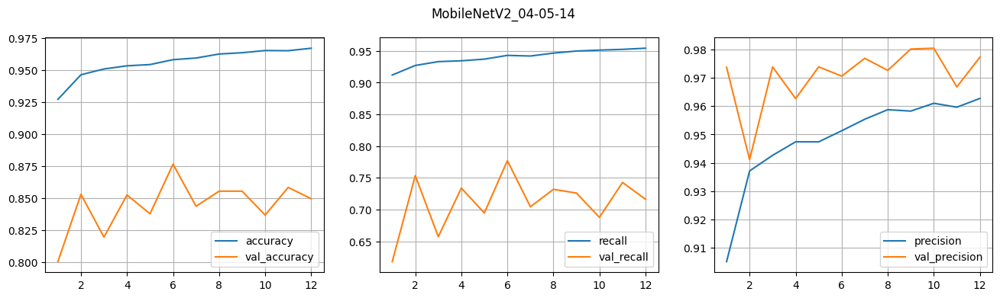

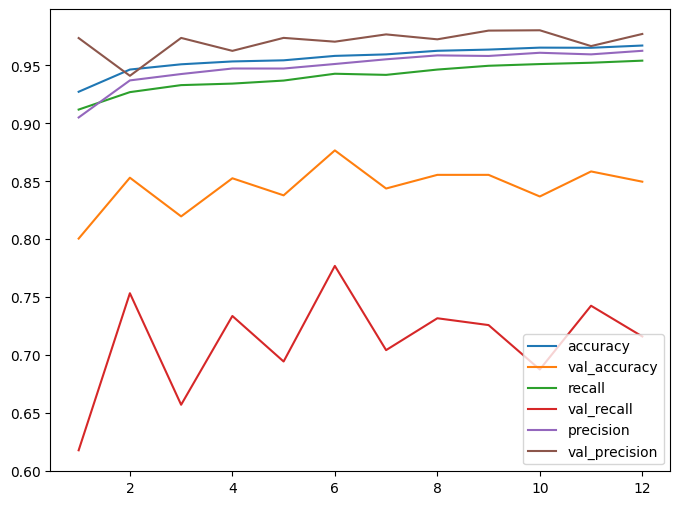

In [ ]:
# MobileNetV2
plot_scores (df_basic, MODEL_NAME, ['accuracy', 'recall', 'precision'])

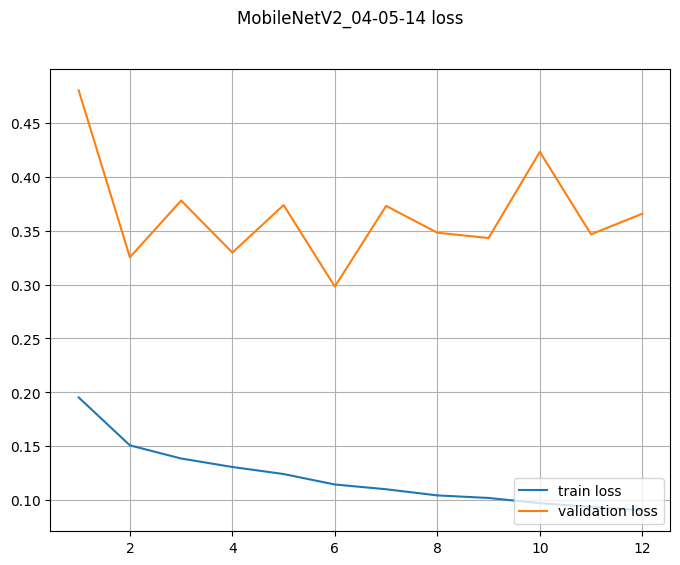

In [ ]:
# MobileNetV2
plot_loss(df_basic, MODEL_NAME)

In [ ]:

model_path = f"/content/small-{label}{MODEL_NAME}.keras"
best_tl_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})

In [ ]:
best_tl_results = best_tl_model.evaluate(test_ds, verbose=1)

268/268 ━━━━━━━━━━━━━━━━━━━━ 17s 48ms/step - accuracy: 0.9328 - auc: 0.9366 - fn: 145.9331 - fp: 135.4126 - loss: 0.1831 - prc: 0.8255 - precision: 0.7337 - recall: 0.7295 - tn: 3632.8811 - tp: 405.5056


In [ ]:
for name, value in zip(best_tl_model.metrics_names, best_tl_results):
  print(name, ': ', value)
print()

loss :  0.17792344093322754
compile_metrics :  0.9374707937240601



In [ ]:
best_tl_results

[0.17792344093322754,
 0.9374707937240601,
 0.764976978302002,
 0.7477477192878723,
 830.0,
 255.0,
 7191.0,
 280.0,
 0.9393799304962158,
 0.841061532497406]

In [ ]:
precision = best_tl_results[2]
recall = best_tl_results[3]
fbeta = fbeta_metric(precision, recall)
best_tl_results.append(fbeta)

In [ ]:
[m.name for m in METRICS]

['accuracy', 'precision', 'recall', 'tp', 'fp', 'tn', 'fn', 'auc', 'prc']

In [ ]:
for name, value in zip(["loss"] + [m.name for m in METRICS] + ["f1_beta"], best_tl_results):
# for name, value in zip([m.name for m in METRICS] + ["f1_beta"], best_tl_results):
  print(name, ': ', value)
print()

loss :  0.17792344093322754
accuracy :  0.9374707937240601
precision :  0.764976978302002
recall :  0.7477477192878723
tp :  830.0
fp :  255.0
tn :  7191.0
fn :  280.0
auc :  0.9393799304962158
prc :  0.841061532497406
f1_beta :  0.7511312025584933



In [ ]:
# Зберегти результат оцінки на тествому наборі
df_eval = pd.DataFrame({'Metric': ["loss"] + METRICS + ["f1_beta"], 'Value': best_tl_results})
df_eval.to_csv(f'evaluate_results_{label}{MODEL_NAME}.csv', index=False)
files.download(f'/content/evaluate_results_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
!rm -rf wandb/ ~/.wandb /tmp/wandb

### fine tuning

In [ ]:
MODEL_NAME

'MobileNetV2_04-05-14'

In [ ]:
labels = ['tl-', 'ft-']
label = labels[1]

In [ ]:
from google.colab import files
files.upload()

In [ ]:
# model_path = "/content/small-ft-MobileNetV2_04-05-08.keras"
model_path = f"/content/small-tl-{MODEL_NAME}.keras"
best_tl_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})

In [ ]:
base_model = best_tl_model.get_layer('mobilenetv2_1.00_224')

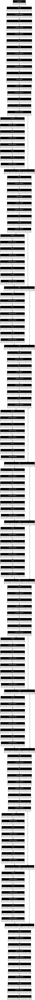

In [ ]:
plot_model(base_model, show_shapes=True)

In [ ]:
for layer in base_model.layers[-20:]:
  layer.trainable=True

for layer in base_model.layers[:-20]:
  layer.trainable=False

In [ ]:
best_tl_model.summary(show_trainable=True)

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Layer (type)                        ┃ Output Shape                 ┃       Param # ┃ Traina… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━┩
│ input_layer_1 (InputLayer)          │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ lambda (Lambda)                     │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ mobilenetv2_1.00_224 (Functional)   │ (None, 8, 8, 1280)           │     2,257,984 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ global_average_pooling2d            │ (None, 1280)                 │             0 │    -    │
│ (GlobalAveragePooling2D)            │                              │               │         │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ dropout (Dropout)                   │ (None, 1280)                 │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ full_con1 (Dense)                   │ (None, 128)                  │       163,968 │    Y    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ pred (Dense)                        │ (None, 1)                    │           129 │    Y    │
└─────────────────────────────────────┴──────────────────────────────┴───────────────┴─────────┘

 Total params: 2,750,277 (10.49 MB)

 Trainable params: 1,370,177 (5.23 MB)

 Non-trainable params: 1,051,904 (4.01 MB)

 Optimizer params: 328,196 (1.25 MB)

In [ ]:
# створити логгер
metrics_logger = MetricsLogger(filepath=f"metrics_logs_{label}{MODEL_NAME}.csv")

In [ ]:
best_tl_model.compile(
    optimizer=keras.optimizers.Adam(learning_rate=1e-6),
    loss=keras.losses.BinaryCrossentropy(),
    metrics=METRICS)

In [ ]:
callbacks_list = [EarlyStopping(monitor='val_accuracy', patience=6),
                  ModelCheckpoint(f'small-{label}{MODEL_NAME}.keras', monitor='val_loss', save_best_only=True),
                  metrics_logger,
                  # WandbMetricsLogger(),
                  # WandbModelCheckpoint(filepath=f"small-{label}{MODEL_NAME}_wandb.keras", monitor="val_loss")
]

epochs=20

In [ ]:
# MobileNetV2 fine tuning
history = best_tl_model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs,
  callbacks=callbacks_list,
  class_weight=class_weights
)

Epoch 1/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 48s 67ms/step - accuracy: 0.8869 - auc: 0.9503 - fn: 609.4070 - fp: 450.7810 - loss: 0.2517 - prc: 0.9460 - precision: 0.8914 - recall: 0.8384 - tn: 5247.0122 - tp: 3487.5806 - val_accuracy: 0.8428 - val_auc: 0.9576 - val_fn: 307.0000 - val_fp: 13.0000 - val_loss: 0.3702 - val_prc: 0.9621 - val_precision: 0.9820 - val_recall: 0.6984 - val_tn: 1005.0000 - val_tp: 711.0000
Epoch 2/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 21s 44ms/step - accuracy: 0.9242 - auc: 0.9723 - fn: 290.8450 - fp: 308.5186 - loss: 0.2057 - prc: 0.9669 - precision: 0.9023 - recall: 0.9073 - tn: 4377.1611 - tp: 2782.0703 - val_accuracy: 0.8276 - val_auc: 0.9534 - val_fn: 339.0000 - val_fp: 12.0000 - val_loss: 0.3918 - val_prc: 0.9583 - val_precision: 0.9826 - val_recall: 0.6670 - val_tn: 1006.0000 - val_tp: 679.0000
Epoch 3/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 22s 44ms/step - accuracy: 0.9287 - auc: 0.9736 - fn: 268.6963 - fp: 269.1818 - loss: 0.2003 - prc: 0.9680 - precision: 0.9096 - reca

In [ ]:
# from google.colab import files

df_basic = pd.DataFrame(history.history)
df_basic.to_csv(f"metrics_{label}{MODEL_NAME}.csv", index=False)

files.download(f'/content/metrics_logs_{label}{MODEL_NAME}.csv')
files.download(f'/content/small-{label}{MODEL_NAME}.keras')
files.download(f'/content/metrics_{label}{MODEL_NAME}.csv')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

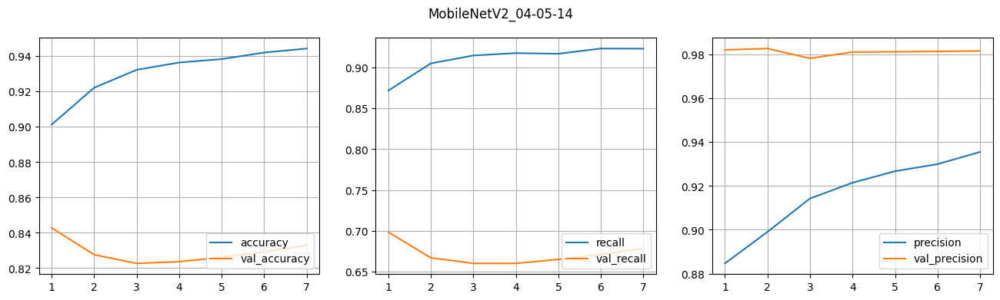

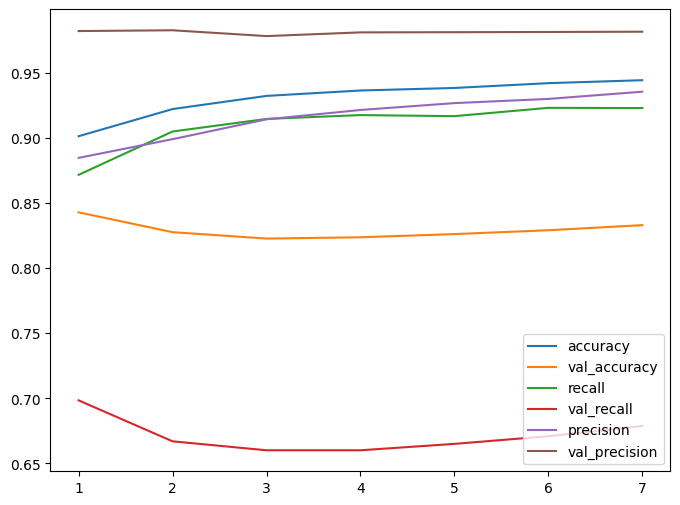

In [ ]:
plot_scores (df_basic, MODEL_NAME, ['accuracy', 'recall', 'precision'])

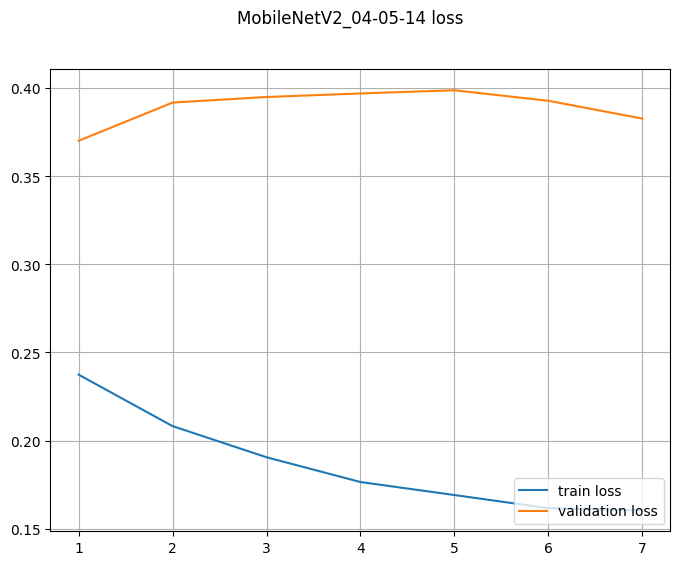

In [ ]:
plot_loss(df_basic, MODEL_NAME)

In [ ]:
# load best model after fine tuning
model_path = f"/content/small-ft-{MODEL_NAME}.keras"
# model_path = "small-ft-MobileNetV2_03-27-10.keras"
best_ft_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})

In [ ]:
best_ft_results = best_ft_model.evaluate(test_ds, verbose=1)

268/268 ━━━━━━━━━━━━━━━━━━━━ 15s 42ms/step - accuracy: 0.9408 - auc: 0.9340 - fn: 173.0781 - fp: 82.2602 - loss: 0.1756 - prc: 0.8247 - precision: 0.8184 - recall: 0.6889 - tn: 3685.8477 - tp: 378.5465


In [ ]:
best_ft_results

[0.17078030109405518,
 0.9424964785575867,
 0.8336933255195618,
 0.6954954862594604,
 772.0,
 154.0,
 7292.0,
 338.0,
 0.937362015247345,
 0.8369210958480835]

In [ ]:
precision = best_ft_results[2]
recall = best_ft_results[3]
fbeta = fbeta_metric(precision, recall)
best_ft_results.append(fbeta)

In [ ]:
for metric, value in zip(["loss"] + [m.name for m in METRICS] + ["f1_beta"], best_ft_results):
  print(metric, ': ', value)
print()

loss :  0.17078030109405518
accuracy :  0.9424964785575867
precision :  0.8336933255195618
recall :  0.6954954862594604
tp :  772.0
fp :  154.0
tn :  7292.0
fn :  338.0
auc :  0.937362015247345
prc :  0.8369210958480835
f1_beta :  0.7193440131106569



In [ ]:
# Зберегти результат оцінки на тествому наборі
df_eval = pd.DataFrame({'Metric': ["loss"] + [m.name for m in METRICS] + ["f1_beta"], 'Value': best_ft_results})
df_eval.to_csv(f'evaluate_results_{label}{MODEL_NAME}.csv', index=False)
files.download(f'/content/evaluate_results_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# for metric in best_ft_model.metrics:
#     metric.reset_state()  # Скинути стан метрик

In [ ]:
# best_ft_results = best_ft_model.evaluate(test_ds, verbose=1)

268/268 ━━━━━━━━━━━━━━━━━━━━ 14s 53ms/step - accuracy: 0.9352 - auc: 0.9552 - fbeta: 0.8184 - fn: 82.0000 - fp: 208.8067 - loss: 0.1918 - prc: 0.8815 - precision: 0.7025 - recall: 0.8537 - tn: 3559.3010 - tp: 469.6245


In [ ]:
# for metric, value in zip(["loss"] + [m.name for m in METRICS] + ["f1_beta"], best_ft_results):
#   print(metric, ': ', value)
# print()

loss :  0.1917123645544052
accuracy :  0.9332631826400757
precision :  0.6980161666870117
recall :  0.8558558821678162
fbeta :  0.8188244104385376
tp :  950.0
fp :  411.0
tn :  7035.0
fn :  160.0
auc :  0.957641065120697
prc :  0.8782067894935608



In [ ]:
predictions_array = []
test_labels_array = []
for images, labels in test_ds:
    predictions = best_ft_model.predict(images, verbose=0)
    predictions_array.extend(predictions)
    test_labels_array.extend(labels.numpy())
predictions_array = np.array(predictions_array)
test_labels_array = np.array(test_labels_array)

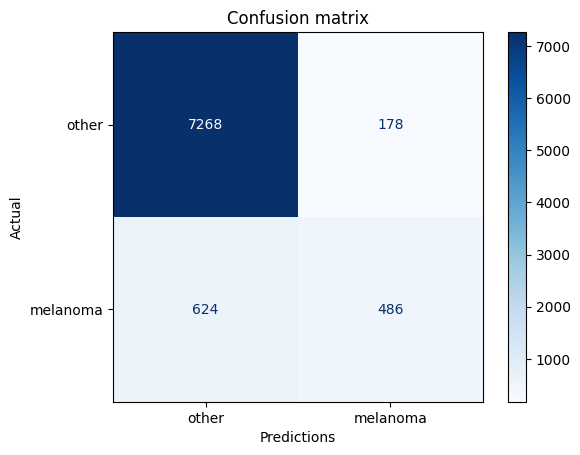

In [ ]:
plot_confusion_matrix(test_labels_array, predictions_array, threshold=0.5)

Додавання зображень з чорним фоном погіршило результат.

## Xception

In [ ]:
!rm -rf wandb/ ~/.wandb /tmp/wandb

transfer learning Xception

! оновити визначення версії, моделі, індекс, базова модель, модель

In [ ]:
labels = ['tl-', 'ft-']
label = labels[0]

In [ ]:
# створення та компіляція transfer learning моделі
tl_model = make_model(metrics=METRICS, model=model, output_bias=initial_bias)
model.summary(show_trainable=True)

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Layer (type)                        ┃ Output Shape                 ┃       Param # ┃ Traina… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━┩
│ input_layer_3 (InputLayer)          │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ lambda_1 (Lambda)                   │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ xception (Functional)               │ (None, 8, 8, 2048)           │    20,861,480 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ global_average_pooling2d_1          │ (None, 2048)                 │             0 │    -    │
│ (GlobalAveragePooling2D)            │                              │               │         │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ dropout_1 (Dropout)                 │ (None, 2048)                 │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ full_con1 (Dense)                   │ (None, 128)                  │       262,272 │    Y    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ pred (Dense)                        │ (None, 1)                    │           129 │    Y    │
└─────────────────────────────────────┴──────────────────────────────┴───────────────┴─────────┘

 Total params: 21,123,881 (80.58 MB)

 Trainable params: 262,401 (1.00 MB)

 Non-trainable params: 20,861,480 (79.58 MB)

In [ ]:
# створити логгер
metrics_logger = MetricsLogger(filepath=f"metrics_logs_{label}{MODEL_NAME}.csv")

In [ ]:
callbacks_list = [EarlyStopping(monitor='val_accuracy', patience=6),
                  ModelCheckpoint(f'small-{label}{MODEL_NAME}.keras', monitor='val_loss', save_best_only=True),
                  metrics_logger,
                  # WandbMetricsLogger(),
                  # WandbModelCheckpoint(filepath=f"small-{label}{MODEL_NAME}_wandb.keras", monitor="val_loss")
]

epochs=20

In [ ]:
# Xception
history = tl_model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs,
  callbacks=callbacks_list,
  class_weight=class_weights
)

Epoch 1/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 108s 193ms/step - accuracy: 0.8891 - auc: 0.9523 - fn: 666.5082 - fp: 326.8760 - loss: 0.2471 - prc: 0.9495 - precision: 0.9143 - recall: 0.8178 - tn: 5378.9668 - tp: 3422.5042 - val_accuracy: 0.8374 - val_auc: 0.9469 - val_fn: 305.0000 - val_fp: 26.0000 - val_loss: 0.3716 - val_prc: 0.9513 - val_precision: 0.9648 - val_recall: 0.7004 - val_tn: 992.0000 - val_tp: 713.0000
Epoch 2/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 84s 173ms/step - accuracy: 0.9399 - auc: 0.9811 - fn: 249.0744 - fp: 216.4236 - loss: 0.1641 - prc: 0.9790 - precision: 0.9277 - recall: 0.9218 - tn: 4460.1758 - tp: 2833.2935 - val_accuracy: 0.8443 - val_auc: 0.9518 - val_fn: 293.0000 - val_fp: 24.0000 - val_loss: 0.3550 - val_prc: 0.9582 - val_precision: 0.9680 - val_recall: 0.7122 - val_tn: 994.0000 - val_tp: 725.0000
Epoch 3/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 84s 172ms/step - accuracy: 0.9470 - auc: 0.9854 - fn: 229.2273 - fp: 190.1797 - loss: 0.1447 - prc: 0.9824 - precision: 0.9392 - re

In [ ]:
from google.colab import files

df_basic = pd.DataFrame(history.history)
df_basic.to_csv(f"metrics_{label}{MODEL_NAME}.csv", index=False)

files.download(f'/content/metrics_logs_{label}{MODEL_NAME}.csv')
files.download(f'/content/small-{label}{MODEL_NAME}.keras')
files.download(f'/content/metrics_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

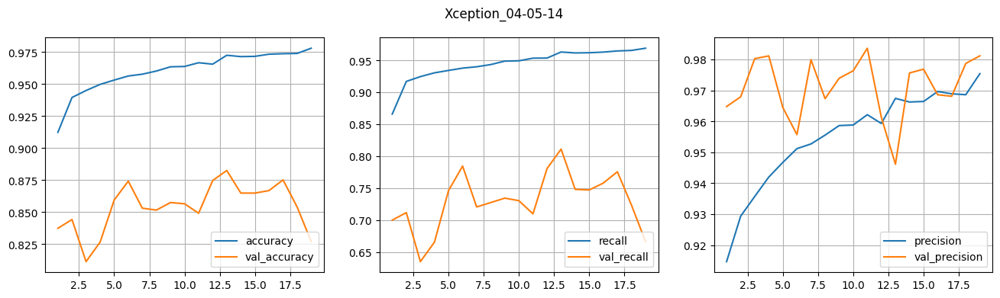

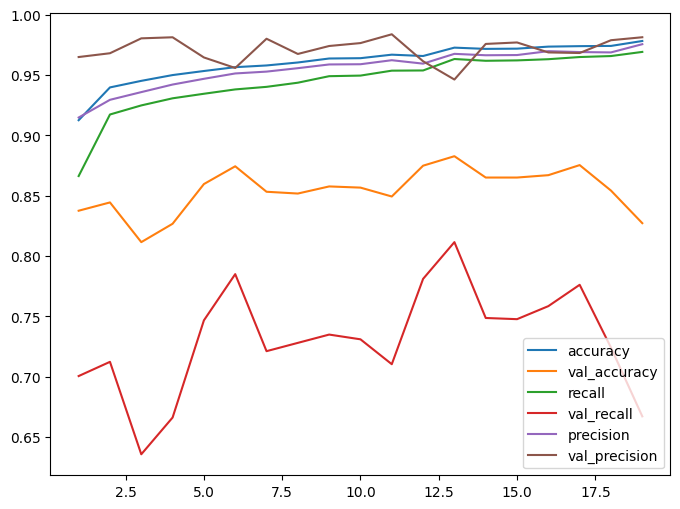

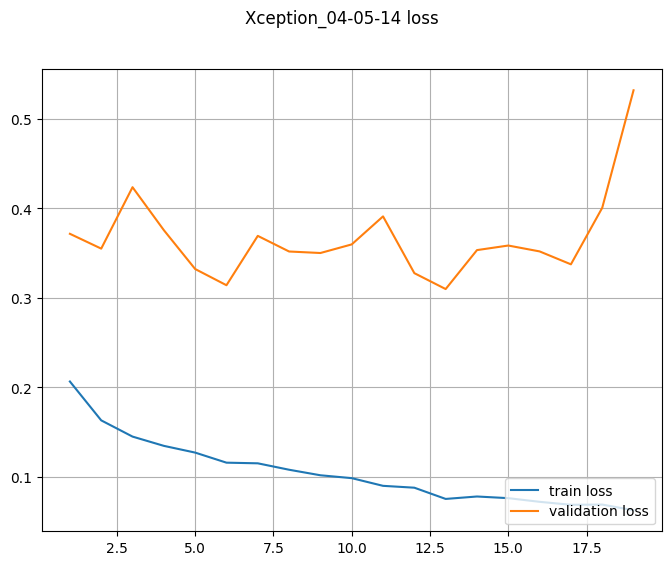

In [ ]:
plot_scores (df_basic, MODEL_NAME, ['accuracy', 'recall', 'precision'])
plot_loss(df_basic, MODEL_NAME)

In [ ]:
model_path = f"/content/small-tl-{MODEL_NAME}.keras"
best_tl_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})

In [ ]:
best_tl_results = best_tl_model.evaluate(test_ds, verbose=1)

268/268 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - accuracy: 0.9280 - auc: 0.9450 - fn: 99.5911 - fp: 198.6431 - loss: 0.2008 - prc: 0.8508 - precision: 0.6805 - recall: 0.8067 - tn: 3568.7844 - tp: 452.7137


In [ ]:
precision = best_tl_results[2]
recall = best_tl_results[3]
fbeta = fbeta_metric(precision, recall)
best_tl_results.append(fbeta)

In [ ]:
for metric, value in zip(["loss"] + [m.name for m in METRICS] + ["f1_beta"], best_tl_results):
  print(metric, ': ', value)
print()

loss :  0.18804126977920532
accuracy :  0.9331463575363159
precision :  0.7062883377075195
recall :  0.8297297358512878
tp :  921.0
fp :  383.0
tn :  7063.0
fn :  189.0
auc :  0.951730489730835
prc :  0.8698709607124329
f1_beta :  0.8017061311980559



In [ ]:
# Зберегти результат оцінки на тествому наборі
df_eval = pd.DataFrame({'Metric': ["loss"] + [m.name for m in METRICS] + ["f1_beta"], 'Value': best_tl_results})
df_eval.to_csv(f'evaluate_results_{label}{MODEL_NAME}.csv', index=False)
files.download(f'/content/evaluate_results_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

fine tuning Xception

In [ ]:
# !rm -rf wandb/ ~/.wandb /tmp/wandb

! Оновити індекс базової моделі

In [ ]:
# labels = ['tl-', 'ft-']
label = labels[1]
print(label, MODEL_NAME)

ft- Xception_04-05-14


In [ ]:
model_path = f"/content/small-tl-{MODEL_NAME}.keras"
best_tl_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})
# ! замінити назву шара:
base_model = best_tl_model.get_layer('xception')
plot_model(base_model, show_shapes=True)

In [ ]:
for layer in base_model.layers[-23:]:
  layer.trainable=True

for layer in base_model.layers[:-23]:
  layer.trainable=False

best_tl_model.summary(show_trainable=True)

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Layer (type)                        ┃ Output Shape                 ┃       Param # ┃ Traina… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━┩
│ input_layer_3 (InputLayer)          │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ lambda_1 (Lambda)                   │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ xception (Functional)               │ (None, 8, 8, 2048)           │    20,861,480 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ global_average_pooling2d_1          │ (None, 2048)                 │             0 │    -    │
│ (GlobalAveragePooling2D)            │                              │               │         │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ dropout_1 (Dropout)                 │ (None, 2048)                 │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ full_con1 (Dense)                   │ (None, 128)                  │       262,272 │    Y    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ pred (Dense)                        │ (None, 1)                    │           129 │    Y    │
└─────────────────────────────────────┴──────────────────────────────┴───────────────┴─────────┘

 Total params: 21,648,685 (82.58 MB)

 Trainable params: 8,126,769 (31.00 MB)

 Non-trainable params: 12,997,112 (49.58 MB)

 Optimizer params: 524,804 (2.00 MB)

In [ ]:
# створити логгер
metrics_logger = MetricsLogger(filepath=f"metrics_logs_{label}{MODEL_NAME}.csv")

best_tl_model.compile(
    optimizer=keras.optimizers.Adam(learning_rate=1e-5),
    loss=keras.losses.BinaryCrossentropy(),
    metrics=METRICS)

callbacks_list = [EarlyStopping(monitor='val_accuracy', patience=6),
                  ModelCheckpoint(f'small-{label}{MODEL_NAME}.keras', monitor='val_loss', save_best_only=True),
                  metrics_logger,
                  # WandbMetricsLogger(),
                  # WandbModelCheckpoint(filepath=f"small-{label}{MODEL_NAME}_wandb.keras", monitor="val_loss")
]

epochs=20

In [ ]:
# Xception fine tuning
history = best_tl_model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs,
  callbacks=callbacks_list,
  class_weight=class_weights
)


Epoch 1/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 141s 252ms/step - accuracy: 0.8908 - auc: 0.9419 - fn: 568.6178 - fp: 385.1756 - loss: 0.2539 - prc: 0.9369 - precision: 0.8961 - recall: 0.8420 - tn: 5326.2935 - tp: 3514.9917 - val_accuracy: 0.8527 - val_auc: 0.9562 - val_fn: 287.0000 - val_fp: 13.0000 - val_loss: 0.3577 - val_prc: 0.9628 - val_precision: 0.9825 - val_recall: 0.7181 - val_tn: 1005.0000 - val_tp: 731.0000
Epoch 2/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 111s 230ms/step - accuracy: 0.9587 - auc: 0.9891 - fn: 196.6178 - fp: 126.2789 - loss: 0.1190 - prc: 0.9866 - precision: 0.9590 - recall: 0.9365 - tn: 4547.6157 - tp: 2887.7852 - val_accuracy: 0.8576 - val_auc: 0.9647 - val_fn: 279.0000 - val_fp: 11.0000 - val_loss: 0.3233 - val_prc: 0.9701 - val_precision: 0.9853 - val_recall: 0.7259 - val_tn: 1007.0000 - val_tp: 739.0000
Epoch 3/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 111s 229ms/step - accuracy: 0.9663 - auc: 0.9938 - fn: 149.9897 - fp: 97.5764 - loss: 0.0956 - prc: 0.9914 - precision: 0.9638 -

In [ ]:
# from google.colab import files

df_basic = pd.DataFrame(history.history)
df_basic.to_csv(f"metrics_{label}{MODEL_NAME}.csv", index=False)

files.download(f'/content/metrics_logs_{label}{MODEL_NAME}.csv')
files.download(f'/content/small-{label}{MODEL_NAME}.keras')
files.download(f'/content/metrics_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

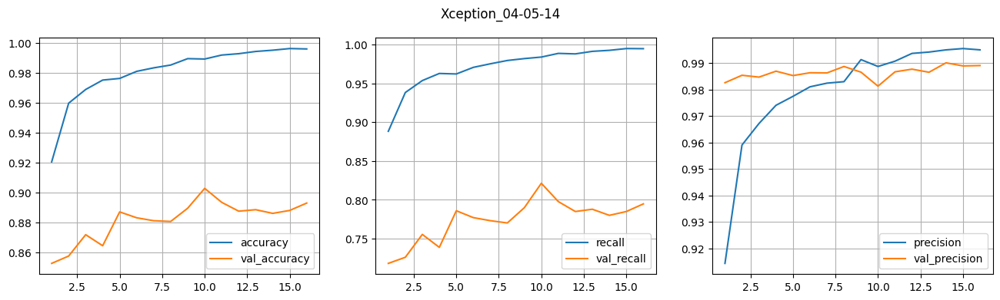

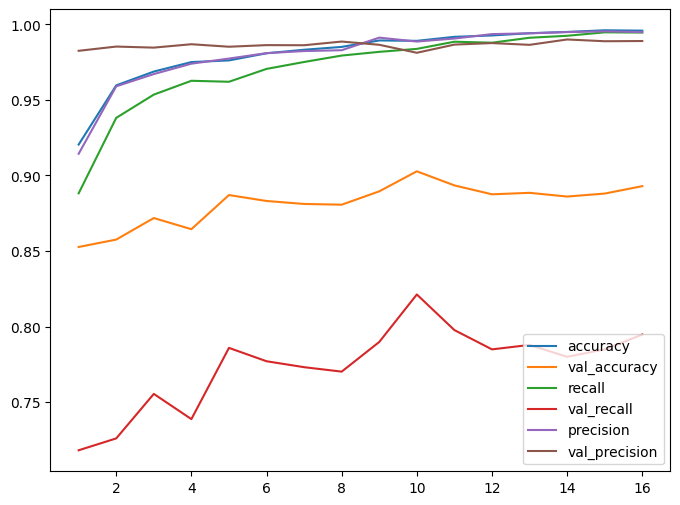

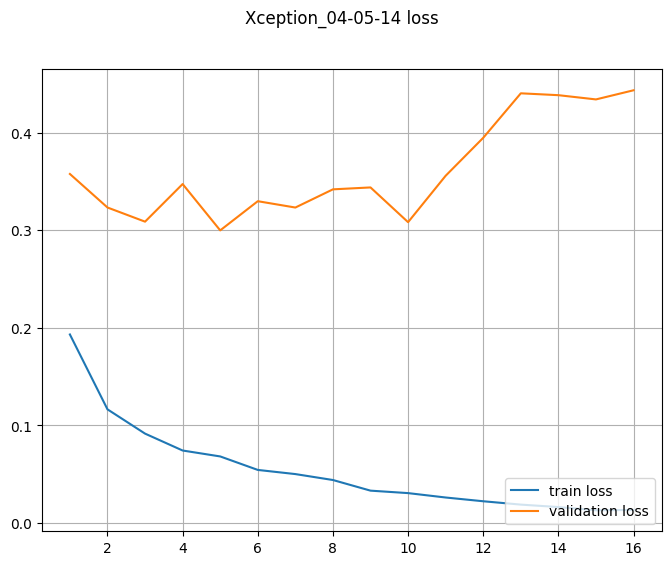

In [ ]:
plot_scores (df_basic, MODEL_NAME, ['accuracy', 'recall', 'precision'])
plot_loss(df_basic, MODEL_NAME)

In [ ]:
# load best model after fine tuning
model_path = f"/content/small-ft-{MODEL_NAME}.keras"
best_ft_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})

best_ft_results = best_ft_model.evaluate(test_ds, verbose=1)

precision = best_ft_results[2]
recall = best_ft_results[3]
fbeta = fbeta_metric(precision, recall)
best_ft_results.append(fbeta)

268/268 ━━━━━━━━━━━━━━━━━━━━ 47s 163ms/step - accuracy: 0.9565 - auc: 0.9615 - fn: 105.0186 - fp: 78.2416 - loss: 0.1311 - prc: 0.8940 - precision: 0.8423 - recall: 0.8087 - tn: 3690.1450 - tp: 446.3271


In [ ]:
for metric, value in zip(["loss"] + [m.name for m in METRICS] + ["f1_beta"], best_ft_results):
  print(metric, ': ', value)
print()

# Зберегти результат оцінки на тествому наборі
df_eval = pd.DataFrame({'Metric': ["loss"] + [m.name for m in METRICS] + ["f1_beta"], 'Value': best_ft_results})
df_eval.to_csv(f'evaluate_results_{label}{MODEL_NAME}.csv', index=False)
files.download(f'/content/evaluate_results_{label}{MODEL_NAME}.csv')

loss :  0.12919440865516663
accuracy :  0.9582749009132385
precision :  0.858913242816925
recall :  0.8117117285728455
tp :  901.0
fp :  148.0
tn :  7298.0
fn :  209.0
auc :  0.9638351202011108
prc :  0.8999343514442444
f1_beta :  0.8207323861866727



<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

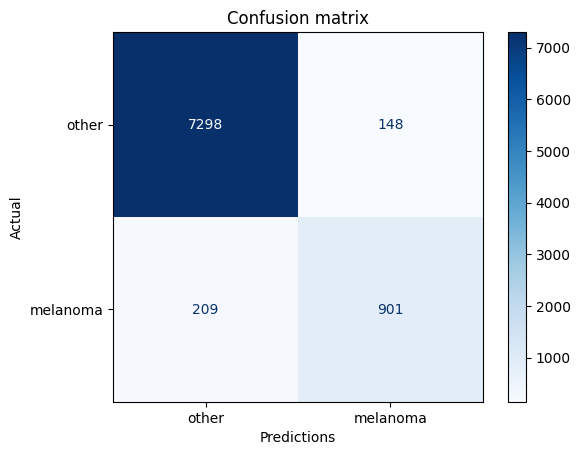

In [ ]:
predictions_array = []
test_labels_array = []
# images_array = []
for images, labels in test_ds:
    predictions = best_ft_model.predict(images, verbose=0)
    predictions_array.extend(predictions)
    test_labels_array.extend(labels.numpy())
    # images_array.extend(images)
predictions_array = np.array(predictions_array)
test_labels_array = np.array(test_labels_array)
# images_array = np.array(images_array)

plot_confusion_matrix(test_labels_array, predictions_array, threshold=0.5)

## ResNet50V2

! оновити визначення версії, моделі, індекс, базова модель, модель

transfer learning

In [ ]:
labels = ['tl-', 'ft-']
label = labels[0]
print(label,  MODEL_NAME)

tl- ResNet50V2_04-05-14


In [ ]:
# створення та компіляція transfer learning моделі
tl_model = make_model(metrics=METRICS, model=model, output_bias=initial_bias)
model.summary(show_trainable=True)

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Layer (type)                        ┃ Output Shape                 ┃       Param # ┃ Traina… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━┩
│ input_layer_5 (InputLayer)          │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ lambda_2 (Lambda)                   │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ resnet50v2 (Functional)             │ (None, 8, 8, 2048)           │    23,564,800 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ global_average_pooling2d_2          │ (None, 2048)                 │             0 │    -    │
│ (GlobalAveragePooling2D)            │                              │               │         │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ dropout_2 (Dropout)                 │ (None, 2048)                 │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ full_con1 (Dense)                   │ (None, 128)                  │       262,272 │    Y    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ pred (Dense)                        │ (None, 1)                    │           129 │    Y    │
└─────────────────────────────────────┴──────────────────────────────┴───────────────┴─────────┘

 Total params: 23,827,201 (90.89 MB)

 Trainable params: 262,401 (1.00 MB)

 Non-trainable params: 23,564,800 (89.89 MB)

In [ ]:
# створити логгер
metrics_logger = MetricsLogger(filepath=f"metrics_logs_{label}{MODEL_NAME}.csv")

callbacks_list = [EarlyStopping(monitor='val_accuracy', patience=6),
                  ModelCheckpoint(f'small-{label}{MODEL_NAME}.keras', monitor='val_loss', save_best_only=True),
                  metrics_logger,
                  # WandbMetricsLogger(),
                  # WandbModelCheckpoint(filepath=f"small-{label}{MODEL_NAME}_wandb.keras", monitor="val_loss")
]
epochs=20

In [ ]:
# ResNet50V2
history = tl_model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs,
  callbacks=callbacks_list,
  class_weight=class_weights
)

Epoch 1/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 76s 126ms/step - accuracy: 0.8938 - auc: 0.9452 - fn: 565.4504 - fp: 419.3285 - loss: 0.2902 - prc: 0.9478 - precision: 0.8956 - recall: 0.8509 - tn: 5284.0205 - tp: 3525.3491 - val_accuracy: 0.8777 - val_auc: 0.9575 - val_fn: 211.0000 - val_fp: 38.0000 - val_loss: 0.2933 - val_prc: 0.9629 - val_precision: 0.9550 - val_recall: 0.7927 - val_tn: 980.0000 - val_tp: 807.0000
Epoch 2/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 45s 92ms/step - accuracy: 0.9392 - auc: 0.9820 - fn: 233.3595 - fp: 245.1054 - loss: 0.1628 - prc: 0.9789 - precision: 0.9206 - recall: 0.9246 - tn: 4450.8223 - tp: 2829.5681 - val_accuracy: 0.8738 - val_auc: 0.9582 - val_fn: 222.0000 - val_fp: 35.0000 - val_loss: 0.2932 - val_prc: 0.9644 - val_precision: 0.9579 - val_recall: 0.7819 - val_tn: 983.0000 - val_tp: 796.0000
Epoch 3/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 44s 91ms/step - accuracy: 0.9415 - auc: 0.9857 - fn: 226.8017 - fp: 217.2045 - loss: 0.1469 - prc: 0.9822 - precision: 0.9258 - recal

In [ ]:
# from google.colab import files

df_basic = pd.DataFrame(history.history)
df_basic.to_csv(f"metrics_{label}{MODEL_NAME}.csv", index=False)

files.download(f'/content/metrics_logs_{label}{MODEL_NAME}.csv')
files.download(f'/content/small-{label}{MODEL_NAME}.keras')
files.download(f'/content/metrics_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

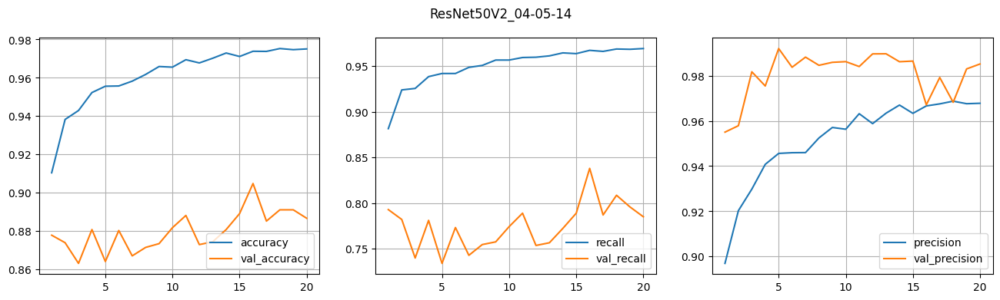

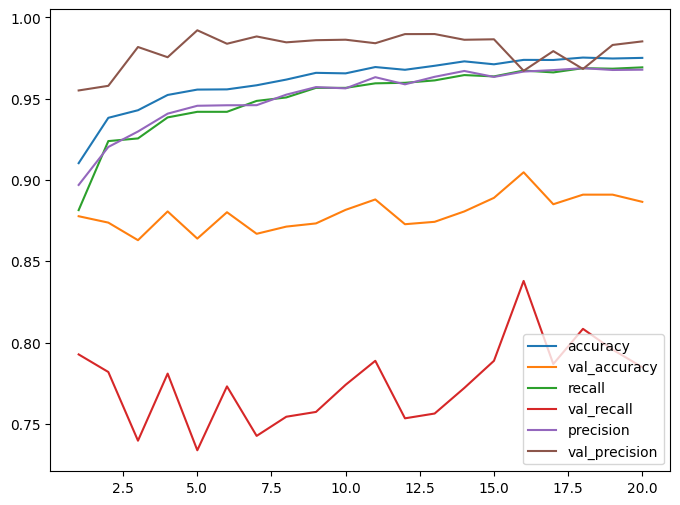

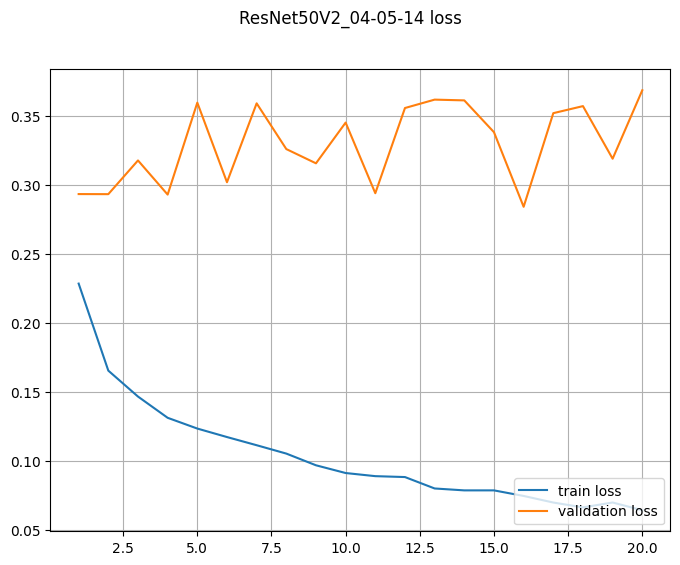

In [ ]:
plot_scores (df_basic, MODEL_NAME, ['accuracy', 'recall', 'precision'])
plot_loss(df_basic, MODEL_NAME)

In [ ]:
model_path = f"/content/small-tl-{MODEL_NAME}.keras"
best_tl_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})

best_tl_results = best_tl_model.evaluate(test_ds, verbose=1)

268/268 ━━━━━━━━━━━━━━━━━━━━ 30s 96ms/step - accuracy: 0.9370 - auc: 0.9545 - fn: 99.7398 - fp: 169.1561 - loss: 0.1813 - prc: 0.8694 - precision: 0.7223 - recall: 0.8249 - tn: 3597.5427 - tp: 453.2937


In [ ]:
precision = best_tl_results[2]
recall = best_tl_results[3]
fbeta = fbeta_metric(precision, recall)
best_tl_results.append(fbeta)

In [ ]:
for metric, value in zip(["loss"] + [m.name for m in METRICS] + ["f1_beta"], best_tl_results):
  print(metric, ': ', value)
print()

loss :  0.17909151315689087
accuracy :  0.9379382729530334
precision :  0.7340339422225952
recall :  0.8180180191993713
tp :  908.0
fp :  329.0
tn :  7117.0
fn :  202.0
auc :  0.9552092552185059
prc :  0.8712007999420166
f1_beta :  0.7997181593186211



In [ ]:
# Зберегти результат оцінки на тествому наборі
df_eval = pd.DataFrame({'Metric': ["loss"] + [m.name for m in METRICS] + ["f1_beta"], 'Value': best_tl_results})
df_eval.to_csv(f'evaluate_results_{label}{MODEL_NAME}.csv', index=False)
files.download(f'/content/evaluate_results_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Fine tuning ResNet50V2

In [ ]:
labels = ['tl-', 'ft-']
label = labels[1]
print(label, "-",  MODEL_NAME)

ft- - ResNet50V2_04-05-14


In [ ]:
model_path = f"/content/small-tl-{MODEL_NAME}.keras"
best_tl_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})
# ! замінити назву шара:
base_model = best_tl_model.get_layer('resnet50v2')
plot_model(base_model, show_shapes=True)

In [ ]:
for layer in base_model.layers[-20:]:
  layer.trainable=True

for layer in base_model.layers[:-20]:
  layer.trainable=False

best_tl_model.summary(show_trainable=True)

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Layer (type)                        ┃ Output Shape                 ┃       Param # ┃ Traina… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━┩
│ input_layer_5 (InputLayer)          │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ lambda_2 (Lambda)                   │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ resnet50v2 (Functional)             │ (None, 8, 8, 2048)           │    23,564,800 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ global_average_pooling2d_2          │ (None, 2048)                 │             0 │    -    │
│ (GlobalAveragePooling2D)            │                              │               │         │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ dropout_2 (Dropout)                 │ (None, 2048)                 │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ full_con1 (Dense)                   │ (None, 128)                  │       262,272 │    Y    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ pred (Dense)                        │ (None, 1)                    │           129 │    Y    │
└─────────────────────────────────────┴──────────────────────────────┴───────────────┴─────────┘

 Total params: 24,352,005 (92.90 MB)

 Trainable params: 8,142,081 (31.06 MB)

 Non-trainable params: 15,685,120 (59.83 MB)

 Optimizer params: 524,804 (2.00 MB)

In [ ]:
# створити логгер
metrics_logger = MetricsLogger(filepath=f"metrics_logs_{label}{MODEL_NAME}.csv")

best_tl_model.compile(
    optimizer=keras.optimizers.Adam(learning_rate=1e-5),
    loss=keras.losses.BinaryCrossentropy(),
    metrics=METRICS)

callbacks_list = [EarlyStopping(monitor='val_accuracy', patience=6),
                  ModelCheckpoint(f'small-{label}{MODEL_NAME}.keras', monitor='val_loss', save_best_only=True),
                  metrics_logger,
                  # WandbMetricsLogger(),
                  # WandbModelCheckpoint(filepath=f"small-{label}{MODEL_NAME}_wandb.keras", monitor="val_loss")
]

epochs=20

In [ ]:
# ResNet50V2 fine tuning
history = best_tl_model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs,
  callbacks=callbacks_list,
  class_weight=class_weights
)

Epoch 1/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 54s 112ms/step - accuracy: 0.9986 - auc: 1.0000 - fn: 6.2748 - fp: 5.0062 - loss: 0.0064 - prc: 1.0000 - precision: 0.9985 - recall: 0.9980 - tn: 4679.8804 - tp: 3067.8057 - val_accuracy: 0.8959 - val_auc: 0.9528 - val_fn: 198.0000 - val_fp: 14.0000 - val_loss: 0.5617 - val_prc: 0.9660 - val_precision: 0.9832 - val_recall: 0.8055 - val_tn: 1004.0000 - val_tp: 820.0000
Epoch 2/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 54s 112ms/step - accuracy: 0.9983 - auc: 1.0000 - fn: 5.3140 - fp: 5.3430 - loss: 0.0051 - prc: 1.0000 - precision: 0.9980 - recall: 0.9979 - tn: 4670.0186 - tp: 3079.0352 - val_accuracy: 0.8973 - val_auc: 0.9514 - val_fn: 197.0000 - val_fp: 12.0000 - val_loss: 0.5749 - val_prc: 0.9660 - val_precision: 0.9856 - val_recall: 0.8065 - val_tn: 1006.0000 - val_tp: 821.0000
Epoch 3/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 55s 113ms/step - accuracy: 0.9987 - auc: 1.0000 - fn: 2.8202 - fp: 6.4050 - loss: 0.0042 - prc: 1.0000 - precision: 0.9976 - recall: 0.999

In [ ]:
# from google.colab import files

df_basic = pd.DataFrame(history.history)
df_basic.to_csv(f"metrics_{label}{MODEL_NAME}.csv", index=False)

files.download(f'/content/metrics_logs_{label}{MODEL_NAME}.csv')
files.download(f'/content/small-{label}{MODEL_NAME}.keras')
files.download(f'/content/metrics_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

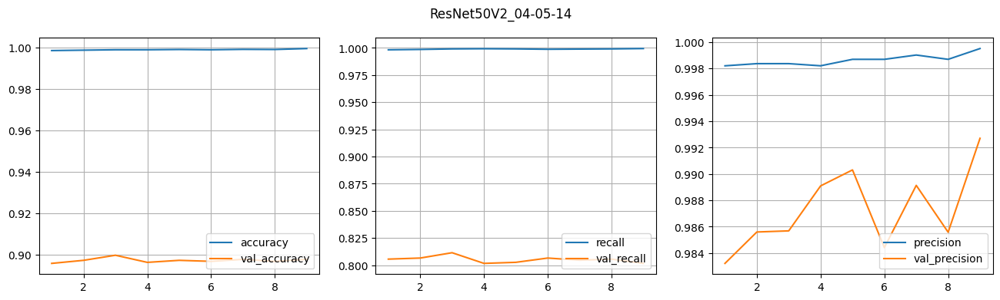

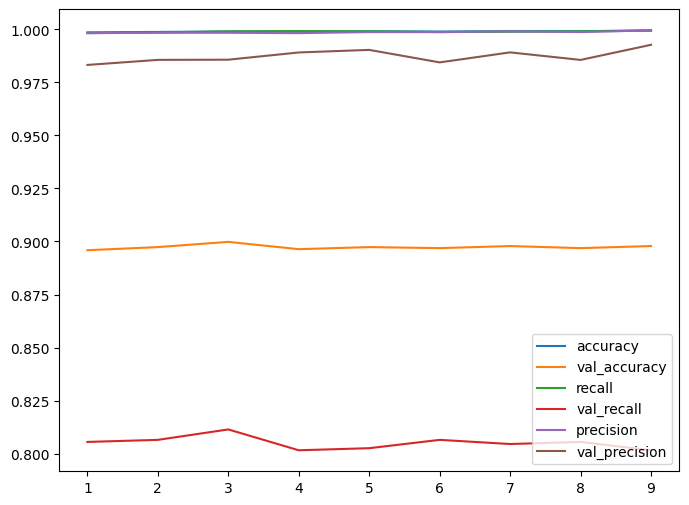

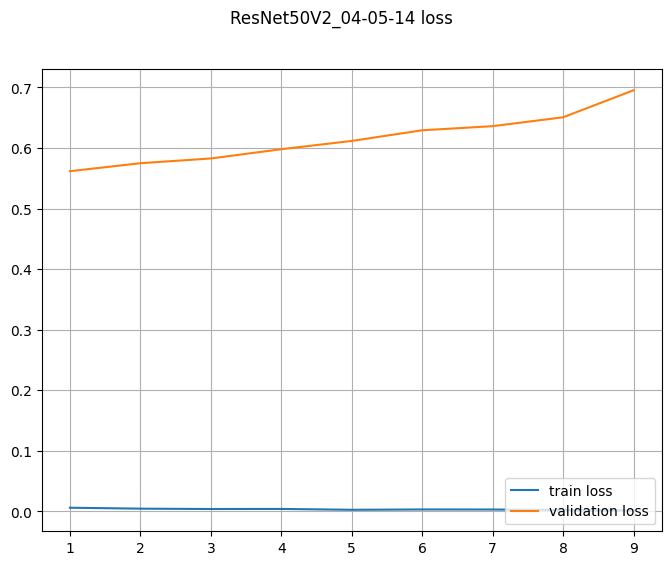

In [ ]:
plot_scores (df_basic, MODEL_NAME, ['accuracy', 'recall', 'precision'])
plot_loss(df_basic, MODEL_NAME)

In [ ]:
# load best model after fine tuning
model_path = f"/content/small-ft-{MODEL_NAME}.keras"
best_ft_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})

best_ft_results = best_ft_model.evaluate(test_ds, verbose=1)

precision = best_ft_results[2]
recall = best_ft_results[3]
fbeta = fbeta_metric(precision, recall)
best_ft_results.append(fbeta)

268/268 ━━━━━━━━━━━━━━━━━━━━ 27s 84ms/step - accuracy: 0.9573 - auc: 0.9521 - fn: 122.7993 - fp: 58.4498 - loss: 0.1494 - prc: 0.8784 - precision: 0.8755 - recall: 0.7760 - tn: 3709.2937 - tp: 429.1896


In [ ]:
for metric, value in zip(["loss"] + [m.name for m in METRICS] + ["f1_beta"], best_ft_results):
  print(metric, ': ', value)
print()

loss :  0.14148998260498047
accuracy :  0.9595605134963989
precision :  0.8905930519104004
recall :  0.7846846580505371
tp :  871.0
fp :  107.0
tn :  7339.0
fn :  239.0
auc :  0.9555329084396362
prc :  0.8888020515441895
f1_beta :  0.8038021194475774



In [ ]:
# Зберегти результат оцінки на тествому наборі
df_eval = pd.DataFrame({'Metric': ["loss"] + [m.name for m in METRICS] + ["f1_beta"], 'Value': best_ft_results})
df_eval.to_csv(f'evaluate_results_{label}{MODEL_NAME}.csv', index=False)
files.download(f'/content/evaluate_results_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

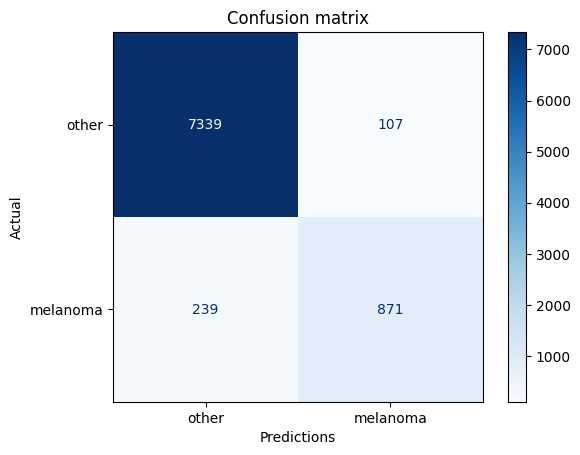

In [ ]:
predictions_array = []
test_labels_array = []
for images, labels in test_ds:
    predictions = best_ft_model.predict(images, verbose=0)
    predictions_array.extend(predictions)
    test_labels_array.extend(labels.numpy())
predictions_array = np.array(predictions_array)
test_labels_array = np.array(test_labels_array)

plot_confusion_matrix(test_labels_array, predictions_array, threshold=0.5)

## InceptionV3

! оновити визначення версії, моделі, індекс, базова модель, модель

### transfer learning

In [ ]:
labels = ['tl-', 'ft-']
label = labels[0]
print(label,  MODEL_NAME)

# створення та компіляція transfer learning моделі
tl_model = make_model(metrics=METRICS, model=model, output_bias=initial_bias)
model.summary(show_trainable=True)

tl- InceptionV3_04-06-14


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Layer (type)                        ┃ Output Shape                 ┃       Param # ┃ Traina… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━┩
│ input_layer_1 (InputLayer)          │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ lambda (Lambda)                     │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ inception_v3 (Functional)           │ (None, 6, 6, 2048)           │    21,802,784 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ global_average_pooling2d            │ (None, 2048)                 │             0 │    -    │
│ (GlobalAveragePooling2D)            │                              │               │         │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ dropout (Dropout)                   │ (None, 2048)                 │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ full_con1 (Dense)                   │ (None, 128)                  │       262,272 │    Y    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ pred (Dense)                        │ (None, 1)                    │           129 │    Y    │
└─────────────────────────────────────┴──────────────────────────────┴───────────────┴─────────┘

 Total params: 22,065,185 (84.17 MB)

 Trainable params: 262,401 (1.00 MB)

 Non-trainable params: 21,802,784 (83.17 MB)

In [ ]:
# створити логгер
metrics_logger = MetricsLogger(filepath=f"metrics_logs_{label}{MODEL_NAME}.csv")

callbacks_list = [EarlyStopping(monitor='val_accuracy', patience=6),
                  ModelCheckpoint(f'small-{label}{MODEL_NAME}.keras', monitor='val_loss', save_best_only=True),
                  metrics_logger,
                  # WandbMetricsLogger(),
                  # WandbModelCheckpoint(filepath=f"small-{label}{MODEL_NAME}_wandb.keras", monitor="val_loss")
]

epochs=20

In [ ]:
# InceptionV3
history = tl_model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs,
  callbacks=callbacks_list,
  class_weight=class_weights
)

Epoch 1/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 88s 136ms/step - accuracy: 0.8434 - auc: 0.9147 - fn: 441.6508 - fp: 584.2645 - loss: 0.3604 - prc: 0.8914 - precision: 0.7872 - recall: 0.8329 - tn: 4101.8203 - tp: 2629.9297 - val_accuracy: 0.8124 - val_auc: 0.9313 - val_fn: 359.0000 - val_fp: 23.0000 - val_loss: 0.4726 - val_prc: 0.9386 - val_precision: 0.9663 - val_recall: 0.6473 - val_tn: 995.0000 - val_tp: 659.0000
Epoch 2/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 45s 90ms/step - accuracy: 0.9057 - auc: 0.9638 - fn: 338.4525 - fp: 386.4442 - loss: 0.2395 - prc: 0.9567 - precision: 0.8759 - recall: 0.8889 - tn: 4300.9399 - tp: 2731.7542 - val_accuracy: 0.8242 - val_auc: 0.9396 - val_fn: 325.0000 - val_fp: 33.0000 - val_loss: 0.3781 - val_prc: 0.9459 - val_precision: 0.9545 - val_recall: 0.6807 - val_tn: 985.0000 - val_tp: 693.0000
Epoch 3/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 43s 88ms/step - accuracy: 0.9172 - auc: 0.9726 - fn: 291.4132 - fp: 347.8843 - loss: 0.2086 - prc: 0.9662 - precision: 0.8890 - recal

In [ ]:
from google.colab import files

df_basic = pd.DataFrame(history.history)
df_basic.to_csv(f"metrics_{label}{MODEL_NAME}.csv", index=False)

files.download(f'/content/metrics_logs_{label}{MODEL_NAME}.csv')
files.download(f'/content/small-{label}{MODEL_NAME}.keras')
files.download(f'/content/metrics_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

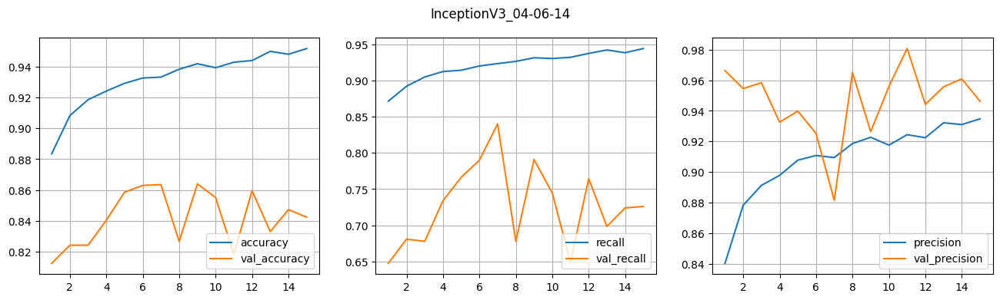

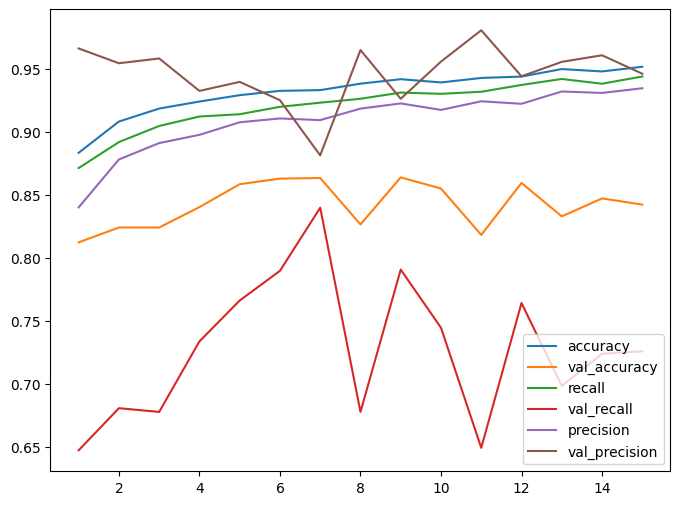

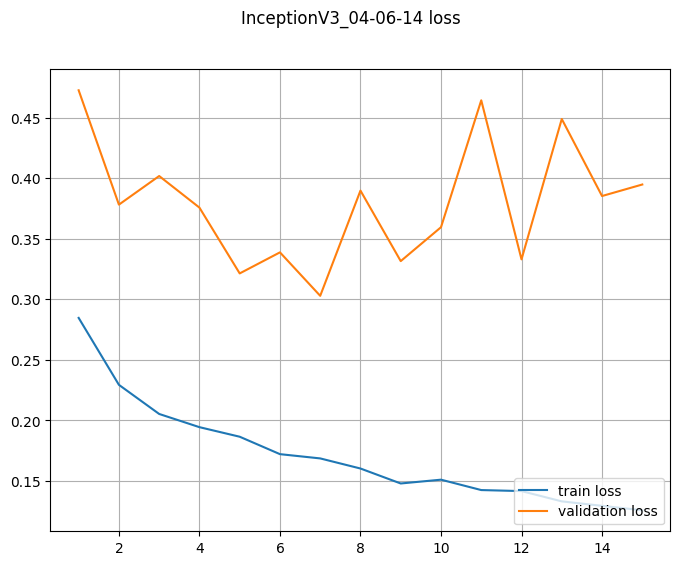

In [ ]:
plot_scores (df_basic, MODEL_NAME, ['accuracy', 'recall', 'precision'])
plot_loss(df_basic, MODEL_NAME)

In [ ]:
model_path = f"/content/small-tl-{MODEL_NAME}.keras"
best_tl_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})

best_tl_results = best_tl_model.evaluate(test_ds, verbose=1)

precision = best_tl_results[2]
recall = best_tl_results[3]
fbeta = fbeta_metric(precision, recall)
best_tl_results.append(fbeta)

268/268 ━━━━━━━━━━━━━━━━━━━━ 33s 97ms/step - accuracy: 0.8523 - auc: 0.9332 - fn: 84.6320 - fp: 543.8030 - loss: 0.3322 - prc: 0.8130 - precision: 0.4533 - recall: 0.8423 - tn: 3224.4907 - tp: 466.8067


In [ ]:
for metric, value in zip(["loss"] + [m.name for m in METRICS] + ["f1_beta"], best_tl_results):
  print(metric, ': ', value)
print()

loss :  0.32113686203956604
accuracy :  0.8596306443214417
precision :  0.477008581161499
recall :  0.8504504561424255
tp :  944.0
fp :  1035.0
tn :  6411.0
fn :  166.0
auc :  0.937549889087677
prc :  0.8177359104156494
f1_beta :  0.7353170266843018



In [ ]:
# Зберегти результат оцінки на тествому наборі
df_eval = pd.DataFrame({'Metric': ["loss"] + [m.name for m in METRICS] + ["f1_beta"], 'Value': best_tl_results})
df_eval.to_csv(f'evaluate_results_{label}{MODEL_NAME}.csv', index=False)
files.download(f'/content/evaluate_results_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### fine tuning

In [ ]:
labels = ['tl-', 'ft-']
label = labels[1]
print(label,  MODEL_NAME)

model_path = f"/content/small-tl-{MODEL_NAME}.keras"
best_tl_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})
# ! замінити назву шара:
base_model = best_tl_model.get_layer('inception_v3')
plot_model(base_model, show_shapes=True)

ft- InceptionV3_04-06-14
"dot" with args ['-Tpng', '/tmp/tmp2ptjie0i/tmpofjp3kwd'] returned code: -6

stdout, stderr:
 b''
b"failed at node 19164[1]\ndot: maze.c:313: chkSgraph: Assertion `np->cells[1]' failed.\n"



AssertionError: "dot" with args ['-Tpng', '/tmp/tmp2ptjie0i/tmpofjp3kwd'] returned code: -6

In [ ]:
tf.keras.utils.model_to_dot(base_model)

In [ ]:
for layer in base_model.layers[-20:]:
  layer.trainable=True

for layer in base_model.layers[:-20]:
  layer.trainable=False

best_tl_model.summary(show_trainable=True)

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Layer (type)                        ┃ Output Shape                 ┃       Param # ┃ Traina… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━┩
│ input_layer_1 (InputLayer)          │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ lambda (Lambda)                     │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ inception_v3 (Functional)           │ (None, 6, 6, 2048)           │    21,802,784 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ global_average_pooling2d            │ (None, 2048)                 │             0 │    -    │
│ (GlobalAveragePooling2D)            │                              │               │         │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ dropout (Dropout)                   │ (None, 2048)                 │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ full_con1 (Dense)                   │ (None, 128)                  │       262,272 │    Y    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ pred (Dense)                        │ (None, 1)                    │           129 │    Y    │
└─────────────────────────────────────┴──────────────────────────────┴───────────────┴─────────┘

 Total params: 22,589,989 (86.17 MB)

 Trainable params: 2,197,761 (8.38 MB)

 Non-trainable params: 19,867,424 (75.79 MB)

 Optimizer params: 524,804 (2.00 MB)

In [ ]:
# створити логгер
metrics_logger = MetricsLogger(filepath=f"metrics_logs_{label}{MODEL_NAME}.csv")

best_tl_model.compile(
    optimizer=keras.optimizers.Adam(learning_rate=1e-5),
    loss=keras.losses.BinaryCrossentropy(),
    metrics=METRICS)

callbacks_list = [EarlyStopping(monitor='val_accuracy', patience=6),
                  ModelCheckpoint(f'small-{label}{MODEL_NAME}.keras', monitor='val_loss', save_best_only=True),
                  metrics_logger,
                  # WandbMetricsLogger(),
                  # WandbModelCheckpoint(filepath=f"small-{label}{MODEL_NAME}_wandb.keras", monitor="val_loss")
]

epochs=20

In [ ]:
# InceptionV3 fine tuning
history = best_tl_model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs,
  callbacks=callbacks_list,
  class_weight=class_weights
)

Epoch 1/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 65s 114ms/step - accuracy: 0.9343 - auc: 0.9823 - fn: 231.8760 - fp: 269.9959 - loss: 0.1672 - prc: 0.9783 - precision: 0.9098 - recall: 0.9271 - tn: 4405.0601 - tp: 2852.2583 - val_accuracy: 0.8492 - val_auc: 0.9458 - val_fn: 255.0000 - val_fp: 52.0000 - val_loss: 0.3591 - val_prc: 0.9505 - val_precision: 0.9362 - val_recall: 0.7495 - val_tn: 966.0000 - val_tp: 763.0000
Epoch 2/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 42s 87ms/step - accuracy: 0.9443 - auc: 0.9856 - fn: 198.6715 - fp: 239.9029 - loss: 0.1502 - prc: 0.9809 - precision: 0.9230 - recall: 0.9363 - tn: 4459.4609 - tp: 2860.2625 - val_accuracy: 0.8566 - val_auc: 0.9457 - val_fn: 257.0000 - val_fp: 35.0000 - val_loss: 0.3552 - val_prc: 0.9519 - val_precision: 0.9560 - val_recall: 0.7475 - val_tn: 983.0000 - val_tp: 761.0000
Epoch 3/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 43s 88ms/step - accuracy: 0.9436 - auc: 0.9860 - fn: 203.2686 - fp: 242.2810 - loss: 0.1480 - prc: 0.9818 - precision: 0.9216 - recal

In [ ]:
from google.colab import files

df_basic = pd.DataFrame(history.history)
df_basic.to_csv(f"metrics_{label}{MODEL_NAME}.csv", index=False)

files.download(f'/content/metrics_logs_{label}{MODEL_NAME}.csv')
files.download(f'/content/small-{label}{MODEL_NAME}.keras')
files.download(f'/content/metrics_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

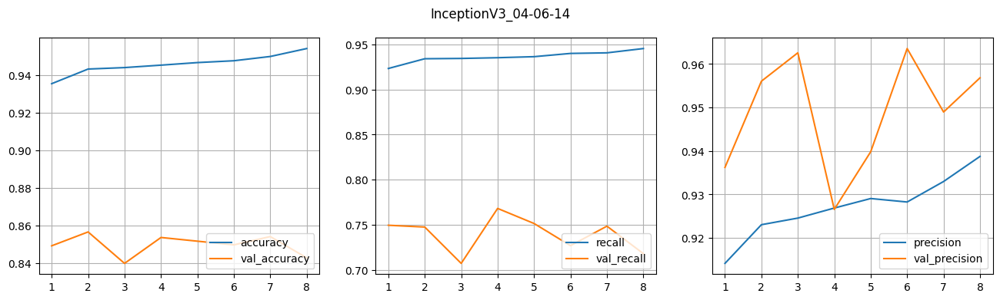

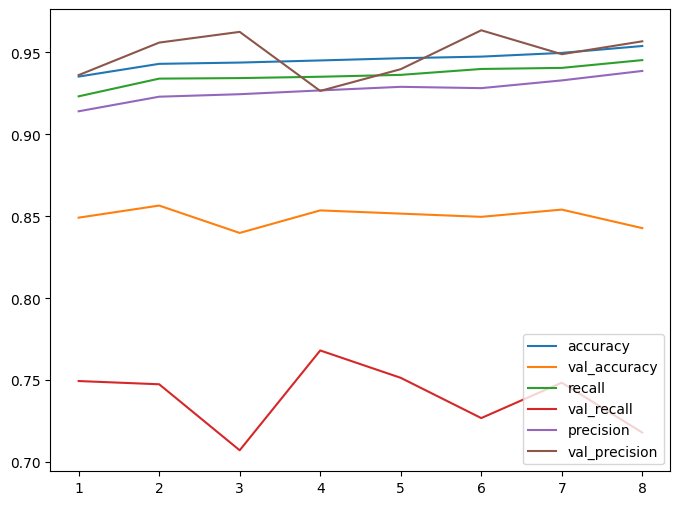

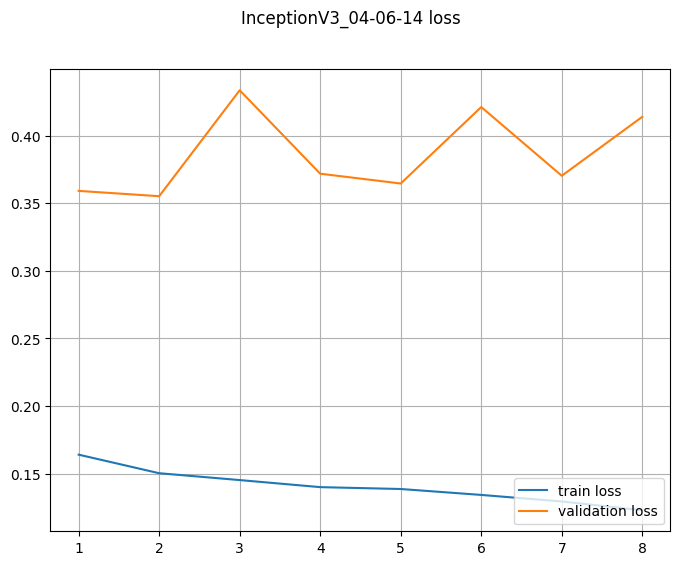

In [ ]:
plot_scores (df_basic, MODEL_NAME, ['accuracy', 'recall', 'precision'])
plot_loss(df_basic, MODEL_NAME)

In [ ]:
# load best model after fine tuning
model_path = f"/content/small-ft-{MODEL_NAME}.keras"
best_ft_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})

best_ft_results = best_ft_model.evaluate(test_ds, verbose=1)

precision = best_ft_results[2]
recall = best_ft_results[3]
fbeta = fbeta_metric(precision, recall)
best_ft_results.append(fbeta)

268/268 ━━━━━━━━━━━━━━━━━━━━ 30s 88ms/step - accuracy: 0.9329 - auc: 0.9496 - fn: 126.6580 - fp: 155.6394 - loss: 0.1778 - prc: 0.8486 - precision: 0.7218 - recall: 0.7745 - tn: 3612.4685 - tp: 424.9666


In [ ]:
for metric, value in zip(["loss"] + [m.name for m in METRICS] + ["f1_beta"], best_ft_results):
  print(metric, ': ', value)
print()

loss :  0.17673304677009583
accuracy :  0.9348995089530945
precision :  0.7389801144599915
recall :  0.7702702879905701
tp :  855.0
fp :  302.0
tn :  7144.0
fn :  255.0
auc :  0.9496109485626221
prc :  0.849579393863678
f1_beta :  0.7638020493466835



In [ ]:
# Зберегти результат оцінки на тествому наборі
df_eval = pd.DataFrame({'Metric': ["loss"] + [m.name for m in METRICS] + ["f1_beta"], 'Value': best_ft_results})
df_eval.to_csv(f'evaluate_results_{label}{MODEL_NAME}.csv', index=False)
files.download(f'/content/evaluate_results_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

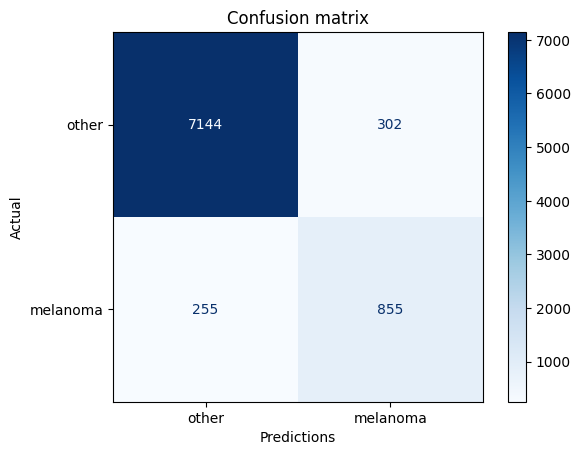

In [ ]:
predictions_array = []
test_labels_array = []
for images, labels in test_ds:
    predictions = best_ft_model.predict(images, verbose=0)
    predictions_array.extend(predictions)
    test_labels_array.extend(labels.numpy())
predictions_array = np.array(predictions_array)
test_labels_array = np.array(test_labels_array)

plot_confusion_matrix(test_labels_array, predictions_array, threshold=0.5)

## ConvNeXtTiny

### Transfer learning

In [ ]:
labels = ['tl-', 'ft-']
label = labels[0]
print(label, MODEL_NAME)

# створення та компіляція transfer learning моделі
tl_model = make_model(metrics=METRICS, model=model, output_bias=initial_bias)
model.summary(show_trainable=True)

tl- ConvNeXtTiny_04-06-14


Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Layer (type)                        ┃ Output Shape                 ┃       Param # ┃ Traina… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━┩
│ input_layer_7 (InputLayer)          │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ lambda_1 (Lambda)                   │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ convnext_tiny (Functional)          │ (None, 8, 8, 768)            │    27,820,128 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ global_average_pooling2d_1          │ (None, 768)                  │             0 │    -    │
│ (GlobalAveragePooling2D)            │                              │               │         │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ dropout_1 (Dropout)                 │ (None, 768)                  │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ full_con1 (Dense)                   │ (None, 128)                  │        98,432 │    Y    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ pred (Dense)                        │ (None, 1)                    │           129 │    Y    │
└─────────────────────────────────────┴──────────────────────────────┴───────────────┴─────────┘

 Total params: 27,918,689 (106.50 MB)

 Trainable params: 98,561 (385.00 KB)

 Non-trainable params: 27,820,128 (106.13 MB)

In [ ]:
# створити логгер
metrics_logger = MetricsLogger(filepath=f"metrics_logs_{label}{MODEL_NAME}.csv")

callbacks_list = [EarlyStopping(monitor='val_accuracy', patience=6),
                  ModelCheckpoint(f'small-{label}{MODEL_NAME}.keras', monitor='val_loss', save_best_only=True),
                  metrics_logger,
                  # WandbMetricsLogger(),
                  # WandbModelCheckpoint(filepath=f"small-{label}{MODEL_NAME}_wandb.keras", monitor="val_loss")
]

epochs=20

In [ ]:
# ConvNeXtTiny
history = tl_model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs,
  callbacks=callbacks_list,
  class_weight=class_weights
)

Epoch 1/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 111s 194ms/step - accuracy: 0.9038 - auc: 0.9587 - fn: 552.1756 - fp: 302.0434 - loss: 0.2343 - prc: 0.9580 - precision: 0.9212 - recall: 0.8481 - tn: 5403.8037 - tp: 3535.7913 - val_accuracy: 0.8639 - val_auc: 0.9563 - val_fn: 258.0000 - val_fp: 19.0000 - val_loss: 0.3404 - val_prc: 0.9639 - val_precision: 0.9756 - val_recall: 0.7466 - val_tn: 999.0000 - val_tp: 760.0000
Epoch 2/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 82s 169ms/step - accuracy: 0.9515 - auc: 0.9865 - fn: 203.8182 - fp: 174.0496 - loss: 0.1378 - prc: 0.9842 - precision: 0.9437 - recall: 0.9332 - tn: 4513.7129 - tp: 2868.0186 - val_accuracy: 0.8531 - val_auc: 0.9616 - val_fn: 287.0000 - val_fp: 12.0000 - val_loss: 0.3521 - val_prc: 0.9692 - val_precision: 0.9838 - val_recall: 0.7181 - val_tn: 1006.0000 - val_tp: 731.0000
Epoch 3/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 82s 169ms/step - accuracy: 0.9539 - auc: 0.9887 - fn: 190.3554 - fp: 159.4979 - loss: 0.1277 - prc: 0.9866 - precision: 0.9457 - r

In [ ]:
from google.colab import files

df_basic = pd.DataFrame(history.history)
df_basic.to_csv(f"metrics_{label}{MODEL_NAME}.csv", index=False)

files.download(f'/content/metrics_logs_{label}{MODEL_NAME}.csv')
files.download(f'/content/small-{label}{MODEL_NAME}.keras')
files.download(f'/content/metrics_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

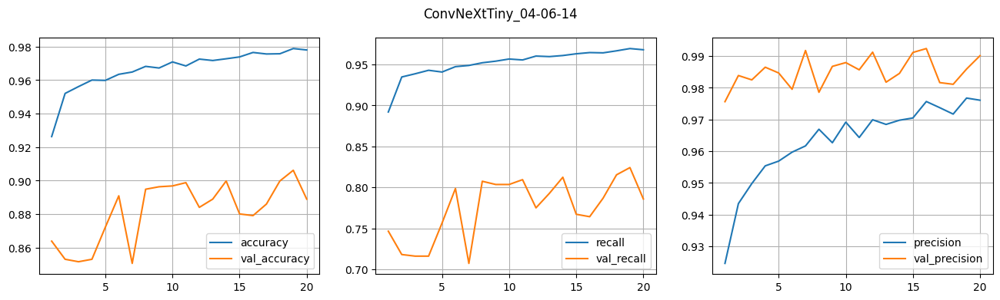

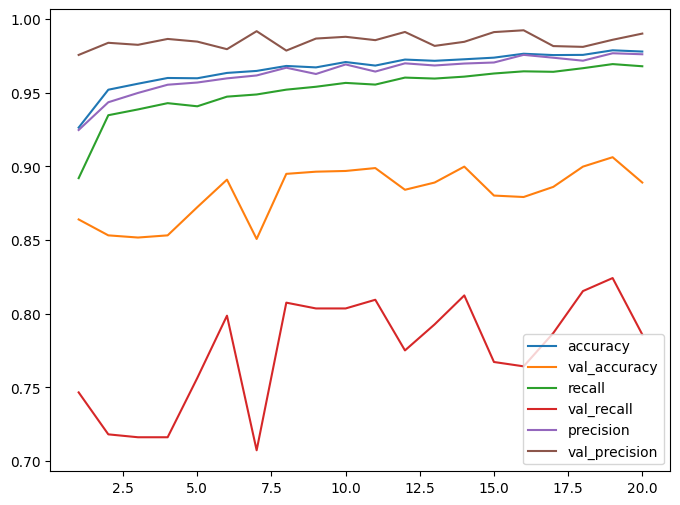

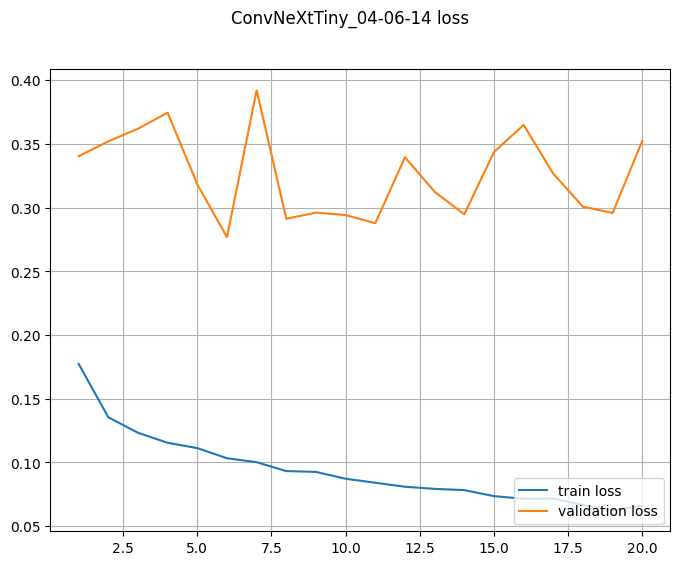

In [ ]:
plot_scores (df_basic, MODEL_NAME, ['accuracy', 'recall', 'precision'])
plot_loss(df_basic, MODEL_NAME)

In [ ]:
model_path = f"/content/small-tl-{MODEL_NAME}.keras"
best_tl_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})

best_tl_results = best_tl_model.evaluate(test_ds, verbose=1)

precision = best_tl_results[2]
recall = best_tl_results[3]
fbeta = fbeta_metric(precision, recall)
best_tl_results.append(fbeta)

268/268 ━━━━━━━━━━━━━━━━━━━━ 46s 154ms/step - accuracy: 0.9480 - auc: 0.9494 - fn: 139.1041 - fp: 82.6059 - loss: 0.1534 - prc: 0.8610 - precision: 0.8260 - recall: 0.7446 - tn: 3684.8215 - tp: 413.2007


In [ ]:
for metric, value in zip(["loss"] + [m.name for m in METRICS] + ["f1_beta"], best_tl_results):
  print(metric, ': ', value)
print()

loss :  0.15000948309898376
accuracy :  0.94974285364151
precision :  0.8386453986167908
recall :  0.7585585713386536
tp :  842.0
fp :  162.0
tn :  7284.0
fn :  268.0
auc :  0.9518216252326965
prc :  0.872492790222168
f1_beta :  0.7733284422485226



In [ ]:
# Зберегти результат оцінки на тествому наборі
df_eval = pd.DataFrame({'Metric': ["loss"] + [m.name for m in METRICS] + ["f1_beta"], 'Value': best_tl_results})
df_eval.to_csv(f'evaluate_results_{label}{MODEL_NAME}.csv', index=False)
files.download(f'/content/evaluate_results_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### fine tuning

In [ ]:
labels = ['tl-', 'ft-']
label = labels[1]
print(label,  MODEL_NAME)

model_path = f"/content/small-tl-{MODEL_NAME}.keras"
best_tl_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})
# ! замінити назву шара:
base_model = best_tl_model.get_layer('convnext_tiny')
plot_model(base_model, show_shapes=True)

ft- ConvNeXtTiny_04-06-14
"dot" with args ['-Tpng', '/tmp/tmp29qoj4eg/tmpgaybuss3'] returned code: -6

stdout, stderr:
 b''
b"failed at node 4461[0]\ndot: maze.c:311: chkSgraph: Assertion `np->cells[0]' failed.\n"



AssertionError: "dot" with args ['-Tpng', '/tmp/tmp29qoj4eg/tmpgaybuss3'] returned code: -6

In [ ]:
for layer in base_model.layers[-20:]:
  layer.trainable=True

for layer in base_model.layers[:-20]:
  layer.trainable=False

best_tl_model.summary(show_trainable=True)

Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Layer (type)                        ┃ Output Shape                 ┃       Param # ┃ Traina… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━┩
│ input_layer_7 (InputLayer)          │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ lambda_1 (Lambda)                   │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ convnext_tiny (Functional)          │ (None, 8, 8, 768)            │    27,820,128 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ global_average_pooling2d_1          │ (None, 768)                  │             0 │    -    │
│ (GlobalAveragePooling2D)            │                              │               │         │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ dropout_1 (Dropout)                 │ (None, 768)                  │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ full_con1 (Dense)                   │ (None, 128)                  │        98,432 │    Y    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ pred (Dense)                        │ (None, 1)                    │           129 │    Y    │
└─────────────────────────────────────┴──────────────────────────────┴───────────────┴─────────┘

 Total params: 28,115,813 (107.25 MB)

 Trainable params: 14,349,569 (54.74 MB)

 Non-trainable params: 13,569,120 (51.76 MB)

 Optimizer params: 197,124 (770.02 KB)

In [ ]:
metrics_logger = MetricsLogger(filepath=f"metrics_logs_{label}{MODEL_NAME}.csv")

best_tl_model.compile(
    optimizer=keras.optimizers.Adam(learning_rate=1e-5),
    loss=keras.losses.BinaryCrossentropy(),
    metrics=METRICS)

callbacks_list = [EarlyStopping(monitor='val_accuracy', patience=6),
                  ModelCheckpoint(f'small-{label}{MODEL_NAME}.keras', monitor='val_loss', save_best_only=True),
                  metrics_logger,
                  # WandbMetricsLogger(),
                  # WandbModelCheckpoint(filepath=f"small-{label}{MODEL_NAME}_wandb.keras", monitor="val_loss")
]

epochs=20

In [ ]:
# ConvNeXtTiny fine tuning
history = best_tl_model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs,
  callbacks=callbacks_list,
  class_weight=class_weights
)

Epoch 1/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 188s 341ms/step - accuracy: 0.9439 - auc: 0.9801 - fn: 374.3264 - fp: 114.8657 - loss: 0.0970 - prc: 0.9814 - precision: 0.9711 - recall: 0.8965 - tn: 5582.4443 - tp: 3724.0000 - val_accuracy: 0.8802 - val_auc: 0.9679 - val_fn: 235.0000 - val_fp: 9.0000 - val_loss: 0.3243 - val_prc: 0.9744 - val_precision: 0.9886 - val_recall: 0.7692 - val_tn: 1009.0000 - val_tp: 783.0000
Epoch 2/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 152s 314ms/step - accuracy: 0.9734 - auc: 0.9948 - fn: 130.6281 - fp: 78.0661 - loss: 0.0815 - prc: 0.9939 - precision: 0.9746 - recall: 0.9581 - tn: 4602.6387 - tp: 2947.2251 - val_accuracy: 0.8875 - val_auc: 0.9697 - val_fn: 220.0000 - val_fp: 9.0000 - val_loss: 0.3212 - val_prc: 0.9759 - val_precision: 0.9888 - val_recall: 0.7839 - val_tn: 1009.0000 - val_tp: 798.0000
Epoch 3/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 152s 314ms/step - accuracy: 0.9741 - auc: 0.9962 - fn: 118.9442 - fp: 83.8161 - loss: 0.0704 - prc: 0.9955 - precision: 0.9728 - re

In [ ]:
# from google.colab import files

df_basic = pd.DataFrame(history.history)
df_basic.to_csv(f"metrics_{label}{MODEL_NAME}.csv", index=False)

files.download(f'/content/metrics_logs_{label}{MODEL_NAME}.csv')
files.download(f'/content/small-{label}{MODEL_NAME}.keras')
files.download(f'/content/metrics_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

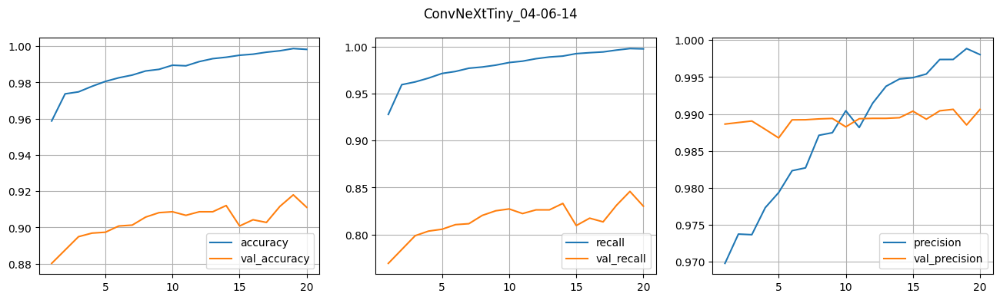

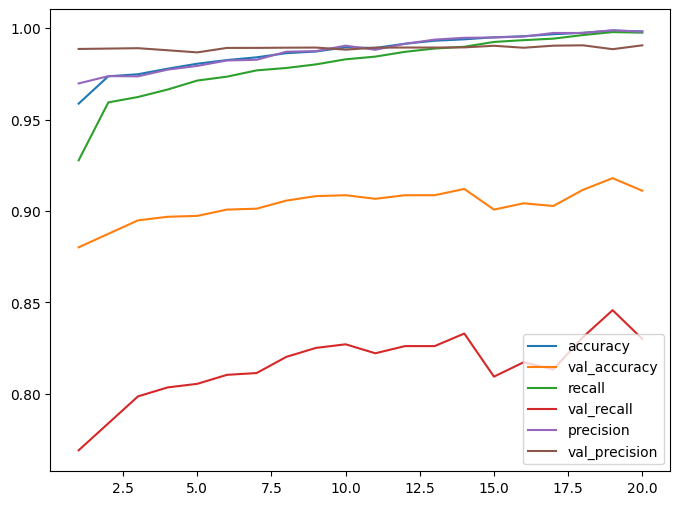

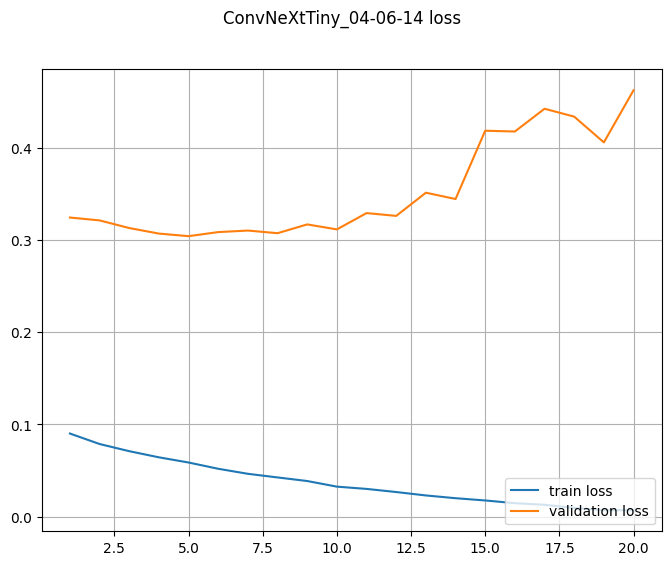

In [ ]:
plot_scores (df_basic, MODEL_NAME, ['accuracy', 'recall', 'precision'])
plot_loss(df_basic, MODEL_NAME)

In [ ]:
last_model = best_tl_model
res=last_model.evaluate(test_ds, verbose=1)
precision = res[2]
recall = res[3]
fbeta = fbeta_metric(precision, recall)
res.append(fbeta)
for metric, value in zip(["loss"] + [m.name for m in METRICS] + ["f1_beta"], res):
  print(metric, ': ', value)
print()

268/268 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - accuracy: 0.9556 - auc: 0.9340 - fn: 133.8773 - fp: 52.2714 - loss: 0.1885 - prc: 0.8721 - precision: 0.8786 - recall: 0.7554 - tn: 3716.1152 - tp: 417.4684
loss :  0.18895983695983887
accuracy :  0.957573652267456
precision :  0.8960763812065125
recall :  0.7612612843513489
tp :  845.0
fp :  98.0
tn :  7348.0
fn :  265.0
auc :  0.9367572665214539
prc :  0.8785021305084229
f1_beta :  0.7848783447461333



Модель з найменшим los на оцінці показує гірші результати, ніж та, що краща за метриками.

In [ ]:
# load best model after fine tuning
model_path = f"/content/small-ft-{MODEL_NAME}.keras"
best_ft_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})

best_ft_results = best_ft_model.evaluate(test_ds, verbose=1)

precision = best_ft_results[2]
recall = best_ft_results[3]
fbeta = fbeta_metric(precision, recall)
best_ft_results.append(fbeta)

268/268 ━━━━━━━━━━━━━━━━━━━━ 47s 160ms/step - accuracy: 0.9546 - auc: 0.9568 - fn: 139.7323 - fp: 53.6952 - loss: 0.1353 - prc: 0.8837 - precision: 0.8766 - recall: 0.7509 - tn: 3713.7510 - tp: 412.5539


In [ ]:
for metric, value in zip(["loss"] + [m.name for m in METRICS] + ["f1_beta"], best_ft_results):
  print(metric, ': ', value)
print()

loss :  0.13427197933197021
accuracy :  0.9564048647880554
precision :  0.8958109617233276
recall :  0.7513513565063477
tp :  834.0
fp :  97.0
tn :  7349.0
fn :  276.0
auc :  0.9570815563201904
prc :  0.8886507153511047
f1_beta :  0.7763917386520716



<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

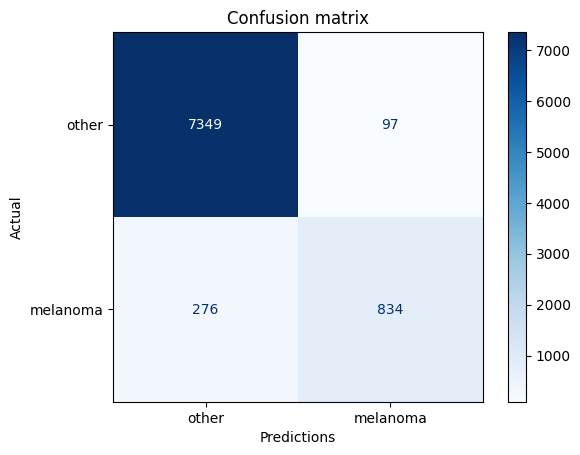

In [ ]:
# Зберегти результат оцінки на тествому наборі
df_eval = pd.DataFrame({'Metric': ["loss"] + [m.name for m in METRICS] + ["f1_beta"], 'Value': best_ft_results})
df_eval.to_csv(f'evaluate_results_{label}{MODEL_NAME}.csv', index=False)
files.download(f'/content/evaluate_results_{label}{MODEL_NAME}.csv')

predictions_array = []
test_labels_array = []
for images, labels in test_ds:
    predictions = best_ft_model.predict(images, verbose=0)
    predictions_array.extend(predictions)
    test_labels_array.extend(labels.numpy())
predictions_array = np.array(predictions_array)
test_labels_array = np.array(test_labels_array)

plot_confusion_matrix(test_labels_array, predictions_array, threshold=0.5)

## DenseNet121

! оновити визначення версії, моделі, індекс, базова модель, модель

### Transfer learning

In [ ]:
labels = ['tl-', 'ft-']
label = labels[0]
print(label, MODEL_NAME)

# створення та компіляція transfer learning моделі
tl_model = make_model(metrics=METRICS, model=model, output_bias=initial_bias)
model.summary(show_trainable=True)

tl- DenseNet121_04-06-14


Model: "functional_38"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Layer (type)                        ┃ Output Shape                 ┃       Param # ┃ Traina… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━┩
│ input_layer_9 (InputLayer)          │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ lambda_2 (Lambda)                   │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ densenet121 (Functional)            │ (None, 8, 8, 1024)           │     7,037,504 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ global_average_pooling2d_2          │ (None, 1024)                 │             0 │    -    │
│ (GlobalAveragePooling2D)            │                              │               │         │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ dropout_2 (Dropout)                 │ (None, 1024)                 │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ full_con1 (Dense)                   │ (None, 128)                  │       131,200 │    Y    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ pred (Dense)                        │ (None, 1)                    │           129 │    Y    │
└─────────────────────────────────────┴──────────────────────────────┴───────────────┴─────────┘

 Total params: 7,168,833 (27.35 MB)

 Trainable params: 131,329 (513.00 KB)

 Non-trainable params: 7,037,504 (26.85 MB)

In [ ]:
# створення та компіляція transfer learning моделі
# tl_model = make_model(metrics=METRICS, model=model, output_bias=initial_bias)
# model.summary(show_trainable=True)

# створити логгер
metrics_logger = MetricsLogger(filepath=f"metrics_logs_{label}{MODEL_NAME}.csv")

callbacks_list = [EarlyStopping(monitor='val_accuracy', patience=6),
                  ModelCheckpoint(f'small-{label}{MODEL_NAME}.keras', monitor='val_loss', save_best_only=True),
                  metrics_logger,
                  # WandbMetricsLogger(),
                  # WandbModelCheckpoint(filepath=f"small-{label}{MODEL_NAME}_wandb.keras", monitor="val_loss")
]

epochs=20

Model: "functional_38"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Layer (type)                        ┃ Output Shape                 ┃       Param # ┃ Traina… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━┩
│ input_layer_9 (InputLayer)          │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ lambda_2 (Lambda)                   │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ densenet121 (Functional)            │ (None, 8, 8, 1024)           │     7,037,504 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ global_average_pooling2d_2          │ (None, 1024)                 │             0 │    -    │
│ (GlobalAveragePooling2D)            │                              │               │         │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ dropout_2 (Dropout)                 │ (None, 1024)                 │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ full_con1 (Dense)                   │ (None, 128)                  │       131,200 │    Y    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ pred (Dense)                        │ (None, 1)                    │           129 │    Y    │
└─────────────────────────────────────┴──────────────────────────────┴───────────────┴─────────┘

 Total params: 7,168,833 (27.35 MB)

 Trainable params: 131,329 (513.00 KB)

 Non-trainable params: 7,037,504 (26.85 MB)

In [ ]:
# DenseNet121
history = tl_model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs,
  callbacks=callbacks_list,
  class_weight=class_weights
)

Epoch 1/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 109s 168ms/step - accuracy: 0.9331 - auc: 0.9572 - fn: 617.7397 - fp: 491.3864 - loss: 0.2761 - prc: 0.9252 - precision: 0.8732 - recall: 0.8395 - tn: 11647.1533 - tp: 3557.2375 - val_accuracy: 0.8114 - val_auc: 0.9460 - val_fn: 373.0000 - val_fp: 11.0000 - val_loss: 0.4401 - val_prc: 0.9544 - val_precision: 0.9832 - val_recall: 0.6336 - val_tn: 1007.0000 - val_tp: 645.0000
Epoch 2/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 48s 99ms/step - accuracy: 0.9323 - auc: 0.9776 - fn: 261.9215 - fp: 255.2438 - loss: 0.1824 - prc: 0.9742 - precision: 0.9145 - recall: 0.9141 - tn: 4434.3345 - tp: 2806.6860 - val_accuracy: 0.8222 - val_auc: 0.9562 - val_fn: 355.0000 - val_fp: 7.0000 - val_loss: 0.4074 - val_prc: 0.9613 - val_precision: 0.9896 - val_recall: 0.6513 - val_tn: 1011.0000 - val_tp: 663.0000
Epoch 3/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 49s 100ms/step - accuracy: 0.9418 - auc: 0.9801 - fn: 239.5620 - fp: 206.7500 - loss: 0.1676 - prc: 0.9777 - precision: 0.9333 - r

In [ ]:
from google.colab import files

df_basic = pd.DataFrame(history.history)
df_basic.to_csv(f"metrics_{label}{MODEL_NAME}.csv", index=False)

files.download(f'/content/metrics_logs_{label}{MODEL_NAME}.csv')
files.download(f'/content/small-{label}{MODEL_NAME}.keras')
files.download(f'/content/metrics_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

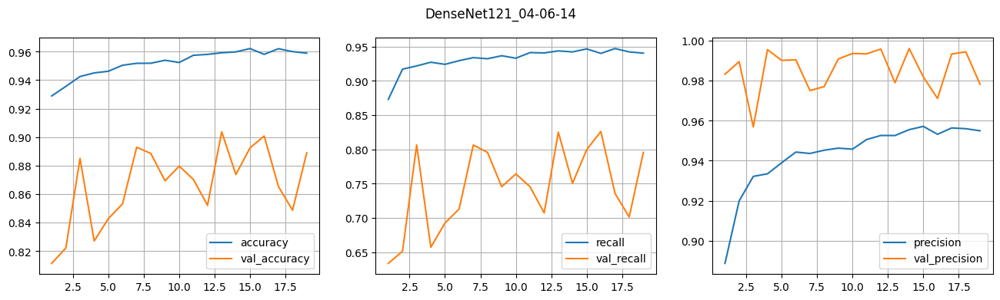

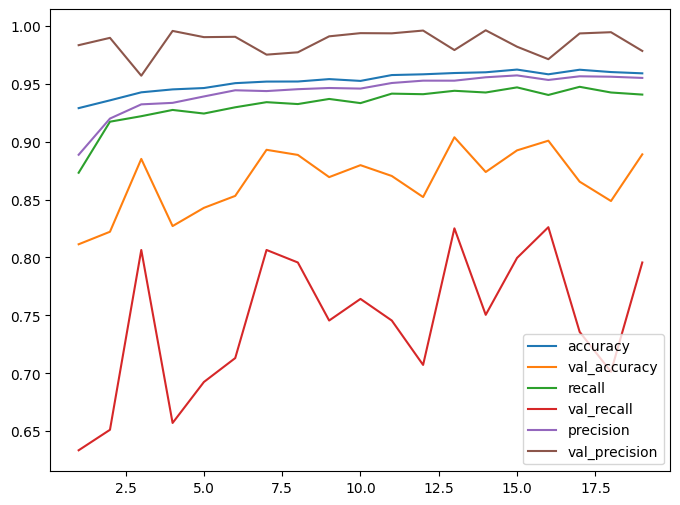

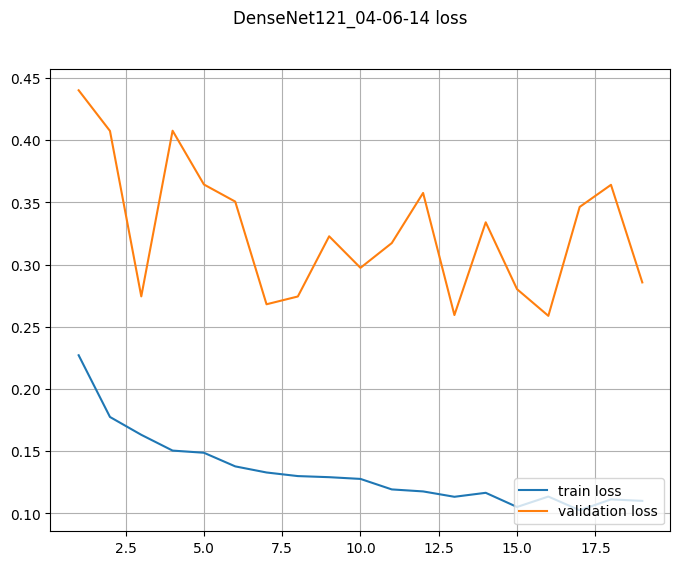

In [ ]:
plot_scores (df_basic, MODEL_NAME, ['accuracy', 'recall', 'precision'])
plot_loss(df_basic, MODEL_NAME)

In [ ]:
model_path = f"/content/small-tl-{MODEL_NAME}.keras"
best_tl_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})

best_tl_results = best_tl_model.evaluate(test_ds, verbose=1)

precision = best_tl_results[2]
recall = best_tl_results[3]
fbeta = fbeta_metric(precision, recall)
best_tl_results.append(fbeta)

268/268 ━━━━━━━━━━━━━━━━━━━━ 43s 122ms/step - accuracy: 0.9502 - auc: 0.9568 - fn: 102.0446 - fp: 102.5688 - loss: 0.1467 - prc: 0.8882 - precision: 0.8042 - recall: 0.8066 - tn: 3664.8401 - tp: 450.2788


In [ ]:
for metric, value in zip(["loss"] + [m.name for m in METRICS] + ["f1_beta"], best_tl_results):
  print(metric, ': ', value)
print()

loss :  0.1402740180492401
accuracy :  0.9543010592460632
precision :  0.824165940284729
recall :  0.823423445224762
tp :  914.0
fp :  195.0
tn :  7251.0
fn :  196.0
auc :  0.9623777270317078
prc :  0.8987922072410583
f1_beta :  0.8235718371906884



In [ ]:
# Зберегти результат оцінки на тествому наборі
df_eval = pd.DataFrame({'Metric': ["loss"] + [m.name for m in METRICS] + ["f1_beta"], 'Value': best_tl_results})
df_eval.to_csv(f'evaluate_results_{label}{MODEL_NAME}.csv', index=False)
files.download(f'/content/evaluate_results_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### fine tuning DenseNet121

ft- DenseNet121_04-06-14


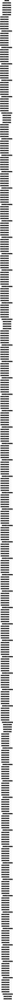

In [ ]:
labels = ['tl-', 'ft-']
label = labels[1]
print(label,  MODEL_NAME)

model_path = f"/content/small-tl-{MODEL_NAME}.keras"
best_tl_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})
# ! замінити назву шара:
base_model = best_tl_model.get_layer('densenet121')
plot_model(base_model, show_shapes=True)

In [ ]:
for layer in base_model.layers[-20:]:
  layer.trainable=True

for layer in base_model.layers[:-20]:
  layer.trainable=False

best_tl_model.summary(show_trainable=True)

Model: "functional_38"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Layer (type)                        ┃ Output Shape                 ┃       Param # ┃ Traina… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━┩
│ input_layer_9 (InputLayer)          │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ lambda_2 (Lambda)                   │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ densenet121 (Functional)            │ (None, 8, 8, 1024)           │     7,037,504 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ global_average_pooling2d_2          │ (None, 1024)                 │             0 │    -    │
│ (GlobalAveragePooling2D)            │                              │               │         │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ dropout_2 (Dropout)                 │ (None, 1024)                 │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ full_con1 (Dense)                   │ (None, 128)                  │       131,200 │    Y    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ pred (Dense)                        │ (None, 1)                    │           129 │    Y    │
└─────────────────────────────────────┴──────────────────────────────┴───────────────┴─────────┘

 Total params: 7,431,493 (28.35 MB)

 Trainable params: 498,497 (1.90 MB)

 Non-trainable params: 6,670,336 (25.45 MB)

 Optimizer params: 262,660 (1.00 MB)

In [ ]:
metrics_logger = MetricsLogger(filepath=f"metrics_logs_{label}{MODEL_NAME}.csv")

best_tl_model.compile(
    optimizer=keras.optimizers.Adam(learning_rate=1e-5),
    loss=keras.losses.BinaryCrossentropy(),
    metrics=METRICS)

callbacks_list = [EarlyStopping(monitor='val_accuracy', patience=6),
                  ModelCheckpoint(f'small-{label}{MODEL_NAME}.keras', monitor='val_loss', save_best_only=True),
                  metrics_logger,
                  # WandbMetricsLogger(),
                  # WandbModelCheckpoint(filepath=f"small-{label}{MODEL_NAME}_wandb.keras", monitor="val_loss")
]

epochs=20

In [ ]:
# DenseNet121 fine tuning
history = best_tl_model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs,
  callbacks=callbacks_list,
  class_weight=class_weights
)

Epoch 1/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 105s 155ms/step - accuracy: 0.9250 - auc: 0.9763 - fn: 298.3285 - fp: 925.7582 - loss: 0.4357 - prc: 0.9547 - precision: 0.8712 - recall: 0.9522 - tn: 8595.9111 - tp: 5938.0020 - val_accuracy: 0.8566 - val_auc: 0.9547 - val_fn: 268.0000 - val_fp: 24.0000 - val_loss: 0.4229 - val_prc: 0.9614 - val_precision: 0.9690 - val_recall: 0.7367 - val_tn: 994.0000 - val_tp: 750.0000
Epoch 2/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 48s 100ms/step - accuracy: 0.9284 - auc: 0.9781 - fn: 201.8058 - fp: 342.7913 - loss: 0.2219 - prc: 0.9635 - precision: 0.8888 - recall: 0.9371 - tn: 4338.2915 - tp: 2875.4463 - val_accuracy: 0.8517 - val_auc: 0.9559 - val_fn: 293.0000 - val_fp: 9.0000 - val_loss: 0.4715 - val_prc: 0.9646 - val_precision: 0.9877 - val_recall: 0.7122 - val_tn: 1009.0000 - val_tp: 725.0000
Epoch 3/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 48s 99ms/step - accuracy: 0.9427 - auc: 0.9812 - fn: 216.6797 - fp: 227.5764 - loss: 0.1926 - prc: 0.9732 - precision: 0.9272 - rec

In [ ]:
# from google.colab import files

df_basic = pd.DataFrame(history.history)
df_basic.to_csv(f"metrics_{label}{MODEL_NAME}.csv", index=False)

files.download(f'/content/metrics_logs_{label}{MODEL_NAME}.csv')
files.download(f'/content/small-{label}{MODEL_NAME}.keras')
files.download(f'/content/metrics_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

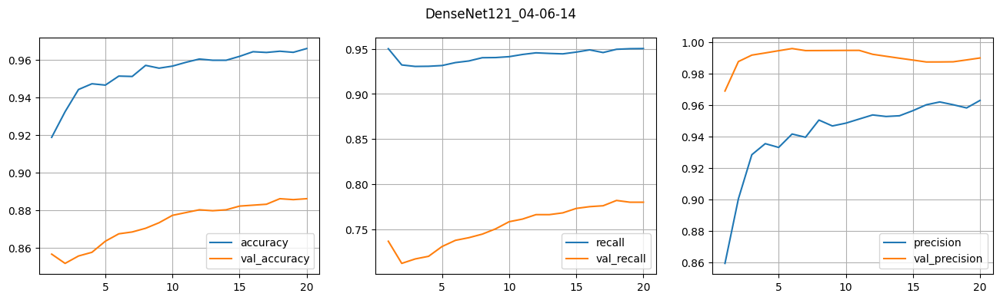

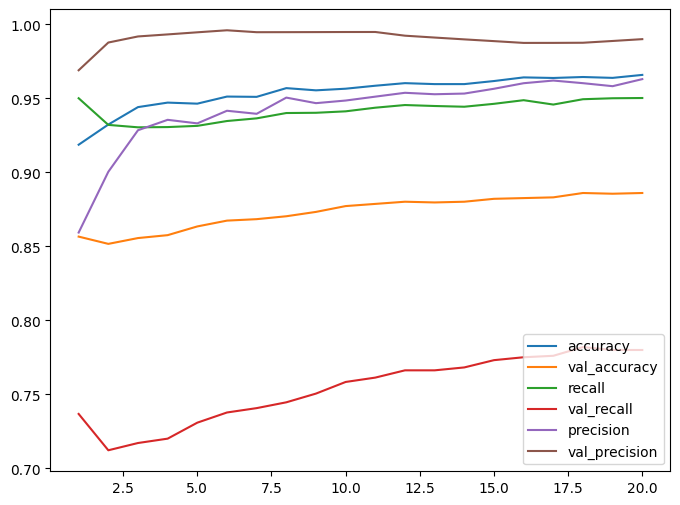

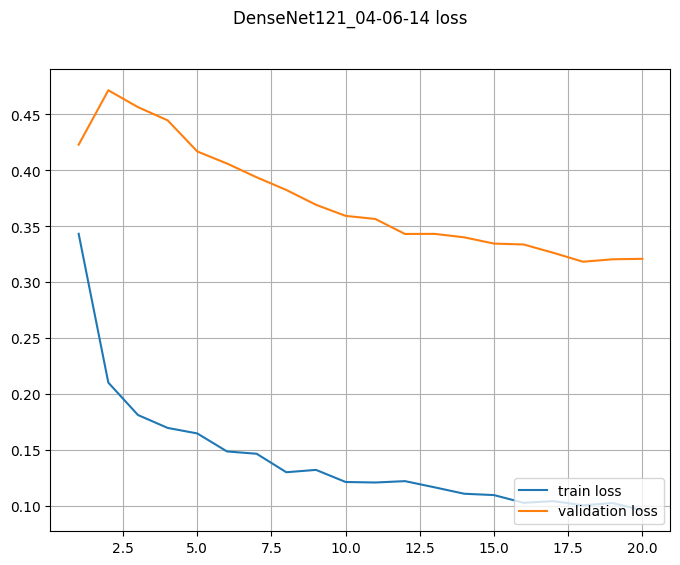

In [ ]:
plot_scores (df_basic, MODEL_NAME, ['accuracy', 'recall', 'precision'])
plot_loss(df_basic, MODEL_NAME)

In [ ]:
# load best model after fine tuning
model_path = f"/content/small-ft-{MODEL_NAME}.keras"
best_ft_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})

best_ft_results = best_ft_model.evaluate(test_ds, verbose=1)

precision = best_ft_results[2]
recall = best_ft_results[3]
fbeta = fbeta_metric(precision, recall)
best_ft_results.append(fbeta)

268/268 ━━━━━━━━━━━━━━━━━━━━ 53s 128ms/step - accuracy: 0.9623 - auc: 0.9557 - fn: 126.9740 - fp: 35.3903 - loss: 0.1307 - prc: 0.8916 - precision: 0.9182 - recall: 0.7710 - tn: 3732.9033 - tp: 424.4647


In [ ]:
for metric, value in zip(["loss"] + [m.name for m in METRICS] + ["f1_beta"], best_ft_results):
  print(metric, ': ', value)
print()

loss :  0.12759770452976227
accuracy :  0.9631837010383606
precision :  0.9278794527053833
recall :  0.776576578617096
tp :  862.0
fp :  67.0
tn :  7379.0
fn :  248.0
auc :  0.959328830242157
prc :  0.8994137048721313
f1_beta :  0.802756569076056



In [ ]:
# Зберегти результат оцінки на тествому наборі
df_eval = pd.DataFrame({'Metric': ["loss"] + [m.name for m in METRICS] + ["f1_beta"], 'Value': best_ft_results})
df_eval.to_csv(f'evaluate_results_{label}{MODEL_NAME}.csv', index=False)
files.download(f'/content/evaluate_results_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

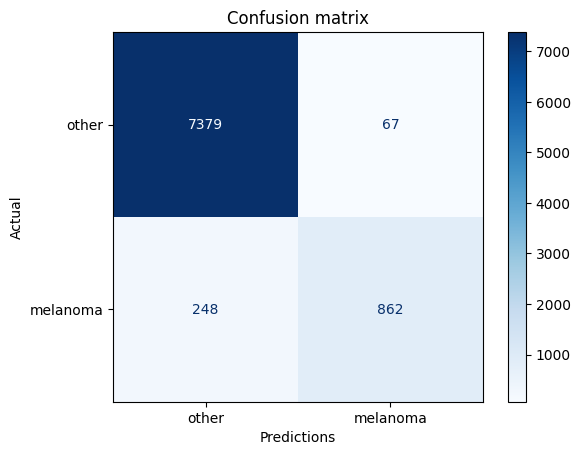

In [ ]:
predictions_array = []
test_labels_array = []
for images, labels in test_ds:
    predictions = best_ft_model.predict(images, verbose=0)
    predictions_array.extend(predictions)
    test_labels_array.extend(labels.numpy())
predictions_array = np.array(predictions_array)
test_labels_array = np.array(test_labels_array)

plot_confusion_matrix(test_labels_array, predictions_array, threshold=0.5)

## NASNetMobile

! оновити визначення версії, моделі, індекс, базова модель, модель

### Transfer learning

In [ ]:
labels = ['tl-', 'ft-']
label = labels[0]
print(label, MODEL_NAME)

# створення та компіляція transfer learning моделі
tl_model = make_model(metrics=METRICS, model=model, output_bias=initial_bias)
model.summary(show_trainable=True)

tl- NASNetMobile_04-06-14


Model: "functional_39"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Layer (type)                        ┃ Output Shape                 ┃       Param # ┃ Traina… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━┩
│ input_layer_11 (InputLayer)         │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ lambda_3 (Lambda)                   │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ nasnet_mobile (Functional)          │ (None, 8, 8, 1056)           │     4,269,716 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ global_average_pooling2d_3          │ (None, 1056)                 │             0 │    -    │
│ (GlobalAveragePooling2D)            │                              │               │         │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ dropout_3 (Dropout)                 │ (None, 1056)                 │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ full_con1 (Dense)                   │ (None, 128)                  │       135,296 │    Y    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ pred (Dense)                        │ (None, 1)                    │           129 │    Y    │
└─────────────────────────────────────┴──────────────────────────────┴───────────────┴─────────┘

 Total params: 4,405,141 (16.80 MB)

 Trainable params: 135,425 (529.00 KB)

 Non-trainable params: 4,269,716 (16.29 MB)

In [ ]:
metrics_logger = MetricsLogger(filepath=f"metrics_logs_{label}{MODEL_NAME}.csv")

callbacks_list = [EarlyStopping(monitor='val_accuracy', patience=6),
                  ModelCheckpoint(f'small-{label}{MODEL_NAME}.keras', monitor='val_loss', save_best_only=True),
                  metrics_logger,
                  # WandbMetricsLogger(),
                  # WandbModelCheckpoint(filepath=f"small-{label}{MODEL_NAME}_wandb.keras", monitor="val_loss")
]

epochs=20

In [ ]:
# NASNetMobile
history = tl_model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs,
  callbacks=callbacks_list,
  class_weight=class_weights
)

Epoch 1/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 34s 70ms/step - accuracy: 0.9628 - auc: 0.9938 - fn: 152.9773 - fp: 135.4897 - loss: 0.0962 - prc: 0.9918 - precision: 0.9559 - recall: 0.9497 - tn: 4547.0103 - tp: 2923.1177 - val_accuracy: 0.8669 - val_auc: 0.9510 - val_fn: 243.0000 - val_fp: 28.0000 - val_loss: 0.3538 - val_prc: 0.9580 - val_precision: 0.9651 - val_recall: 0.7613 - val_tn: 990.0000 - val_tp: 775.0000
Epoch 2/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 34s 70ms/step - accuracy: 0.9656 - auc: 0.9943 - fn: 143.5021 - fp: 131.9256 - loss: 0.0925 - prc: 0.9918 - precision: 0.9569 - recall: 0.9560 - tn: 4560.8389 - tp: 2921.7334 - val_accuracy: 0.8531 - val_auc: 0.9502 - val_fn: 276.0000 - val_fp: 23.0000 - val_loss: 0.3762 - val_prc: 0.9572 - val_precision: 0.9699 - val_recall: 0.7289 - val_tn: 995.0000 - val_tp: 742.0000
Epoch 3/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 34s 70ms/step - accuracy: 0.9649 - auc: 0.9940 - fn: 138.4256 - fp: 137.5083 - loss: 0.0939 - prc: 0.9922 - precision: 0.9568 - recall

In [ ]:
from google.colab import files

df_basic = pd.DataFrame(history.history)
df_basic.to_csv(f"metrics_{label}{MODEL_NAME}.csv", index=False)

files.download(f'/content/metrics_logs_{label}{MODEL_NAME}.csv')
files.download(f'/content/small-{label}{MODEL_NAME}.keras')
files.download(f'/content/metrics_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

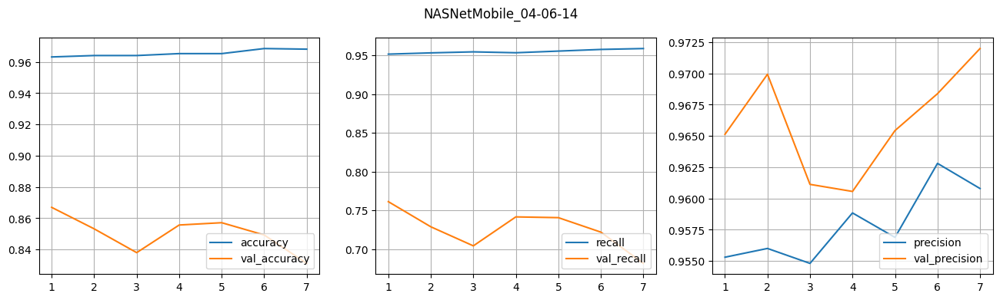

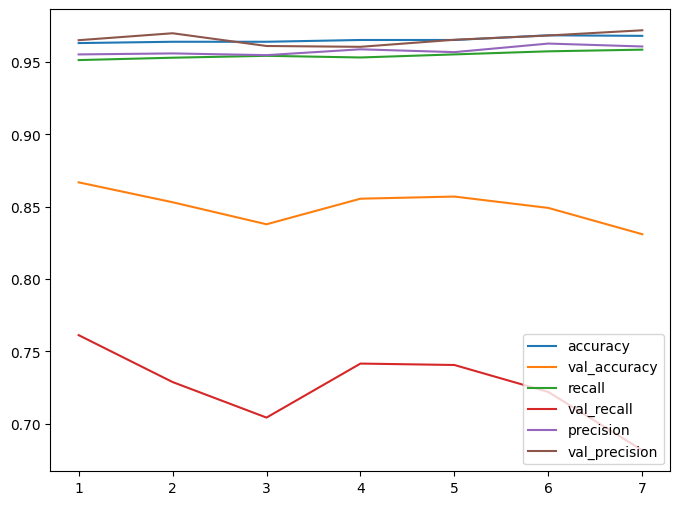

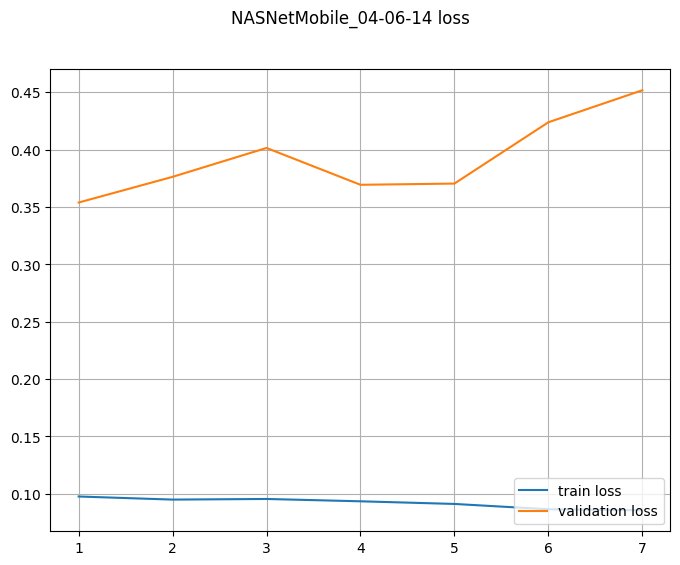

In [ ]:
plot_scores (df_basic, MODEL_NAME, ['accuracy', 'recall', 'precision'])
plot_loss(df_basic, MODEL_NAME)

In [ ]:
model_path = f"/content/small-tl-{MODEL_NAME}.keras"
best_tl_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})

best_tl_results = best_tl_model.evaluate(test_ds, verbose=1)

precision = best_tl_results[2]
recall = best_tl_results[3]
fbeta = fbeta_metric(precision, recall)
best_tl_results.append(fbeta)

268/268 ━━━━━━━━━━━━━━━━━━━━ 40s 98ms/step - accuracy: 0.9355 - auc: 0.9327 - fn: 130.3271 - fp: 150.8401 - loss: 0.1956 - prc: 0.8395 - precision: 0.7332 - recall: 0.7678 - tn: 3616.2566 - tp: 422.3086


In [ ]:
for metric, value in zip(["loss"] + [m.name for m in METRICS] + ["f1_beta"], best_tl_results):
  print(metric, ': ', value)
print()

loss :  0.19299066066741943
accuracy :  0.9347826242446899
precision :  0.739168107509613
recall :  0.76846843957901
tp :  853.0
fp :  301.0
tn :  7145.0
fn :  257.0
auc :  0.9360833764076233
prc :  0.8471559882164001
f1_beta :  0.7624240022670786



In [ ]:
# Зберегти результат оцінки на тествому наборі
df_eval = pd.DataFrame({'Metric': ["loss"] + [m.name for m in METRICS] + ["f1_beta"], 'Value': best_tl_results})
df_eval.to_csv(f'evaluate_results_{label}{MODEL_NAME}.csv', index=False)
files.download(f'/content/evaluate_results_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### fine tuning

In [ ]:
labels = ['tl-', 'ft-']
label = labels[1]
print(label,  MODEL_NAME)

model_path = f"/content/small-tl-{MODEL_NAME}.keras"
best_tl_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})
# ! замінити назву шара:
base_model = best_tl_model.get_layer('nasnet_mobile')
plot_model(base_model, show_shapes=True)

ft- NASNetMobile_04-06-14


In [ ]:
for layer in base_model.layers[-20:]:
  layer.trainable=True

for layer in base_model.layers[:-20]:
  layer.trainable=False

best_tl_model.summary(show_trainable=True)

Model: "functional_39"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Layer (type)                        ┃ Output Shape                 ┃       Param # ┃ Traina… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━┩
│ input_layer_11 (InputLayer)         │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ lambda_3 (Lambda)                   │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ nasnet_mobile (Functional)          │ (None, 8, 8, 1056)           │     4,269,716 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ global_average_pooling2d_3          │ (None, 1056)                 │             0 │    -    │
│ (GlobalAveragePooling2D)            │                              │               │         │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ dropout_3 (Dropout)                 │ (None, 1056)                 │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ full_con1 (Dense)                   │ (None, 128)                  │       135,296 │    Y    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ pred (Dense)                        │ (None, 1)                    │           129 │    Y    │
└─────────────────────────────────────┴──────────────────────────────┴───────────────┴─────────┘

 Total params: 4,675,993 (17.84 MB)

 Trainable params: 305,617 (1.17 MB)

 Non-trainable params: 4,099,524 (15.64 MB)

 Optimizer params: 270,852 (1.03 MB)

In [ ]:
metrics_logger = MetricsLogger(filepath=f"metrics_logs_{label}{MODEL_NAME}.csv")

best_tl_model.compile(
    optimizer=keras.optimizers.Adam(learning_rate=1e-5),
    loss=keras.losses.BinaryCrossentropy(),
    metrics=METRICS)

callbacks_list = [EarlyStopping(monitor='val_accuracy', patience=6),
                  ModelCheckpoint(f'small-{label}{MODEL_NAME}.keras', monitor='val_loss', save_best_only=True),
                  metrics_logger,
                  # WandbMetricsLogger(),
                  # WandbModelCheckpoint(filepath=f"small-{label}{MODEL_NAME}_wandb.keras", monitor="val_loss")
]

epochs=20

In [ ]:
# NASNetMobile fine tuning
history = tl_model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs,
  callbacks=callbacks_list,
  class_weight=class_weights
)

Epoch 1/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 35s 72ms/step - accuracy: 0.9727 - auc: 0.9962 - fn: 103.5227 - fp: 111.3616 - loss: 0.0723 - prc: 0.9946 - precision: 0.9645 - recall: 0.9668 - tn: 4573.9897 - tp: 2970.2046 - val_accuracy: 0.8477 - val_auc: 0.9460 - val_fn: 270.0000 - val_fp: 40.0000 - val_loss: 0.4046 - val_prc: 0.9534 - val_precision: 0.9492 - val_recall: 0.7348 - val_tn: 978.0000 - val_tp: 748.0000
Epoch 2/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 34s 71ms/step - accuracy: 0.9755 - auc: 0.9976 - fn: 101.7810 - fp: 92.7624 - loss: 0.0631 - prc: 0.9966 - precision: 0.9718 - recall: 0.9664 - tn: 4594.9443 - tp: 2969.1445 - val_accuracy: 0.8458 - val_auc: 0.9440 - val_fn: 278.0000 - val_fp: 36.0000 - val_loss: 0.4256 - val_prc: 0.9510 - val_precision: 0.9536 - val_recall: 0.7269 - val_tn: 982.0000 - val_tp: 740.0000
Epoch 3/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 35s 71ms/step - accuracy: 0.9750 - auc: 0.9971 - fn: 92.6591 - fp: 101.5909 - loss: 0.0659 - prc: 0.9962 - precision: 0.9664 - recall: 

In [ ]:
# from google.colab import files

df_basic = pd.DataFrame(history.history)
df_basic.to_csv(f"metrics_{label}{MODEL_NAME}.csv", index=False)

files.download(f'/content/metrics_logs_{label}{MODEL_NAME}.csv')
files.download(f'/content/small-{label}{MODEL_NAME}.keras')
files.download(f'/content/metrics_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

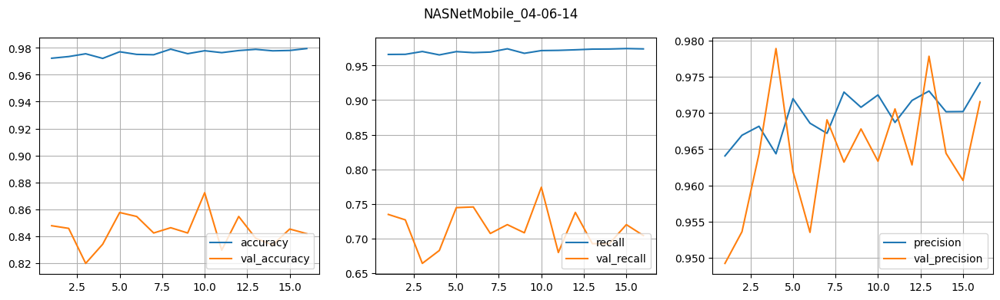

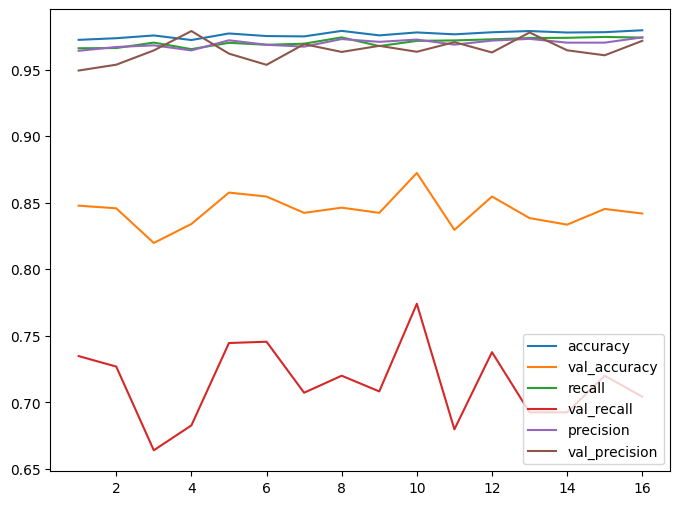

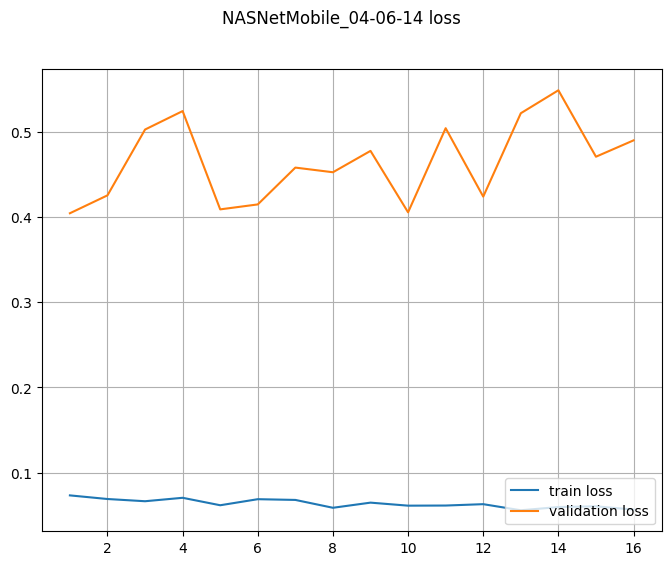

In [ ]:
plot_scores (df_basic, MODEL_NAME, ['accuracy', 'recall', 'precision'])
plot_loss(df_basic, MODEL_NAME)

In [ ]:
# load best model after fine tuning
model_path = f"/content/small-ft-{MODEL_NAME}.keras"
best_ft_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})

best_ft_results = best_ft_model.evaluate(test_ds, verbose=1)

precision = best_ft_results[2]
recall = best_ft_results[3]
fbeta = fbeta_metric(precision, recall)
best_ft_results.append(fbeta)

268/268 ━━━━━━━━━━━━━━━━━━━━ 37s 88ms/step - accuracy: 0.9403 - auc: 0.9288 - fn: 140.0558 - fp: 116.4238 - loss: 0.1869 - prc: 0.8315 - precision: 0.7740 - recall: 0.7431 - tn: 3651.8774 - tp: 411.3755


In [ ]:
for metric, value in zip(["loss"] + [m.name for m in METRICS] + ["f1_beta"], best_ft_results):
  print(metric, ': ', value)
print()

loss :  0.17991016805171967
accuracy :  0.9420289993286133
precision :  0.7869158983230591
recall :  0.7585585713386536
tp :  842.0
fp :  228.0
tn :  7218.0
fn :  268.0
auc :  0.9352489709854126
prc :  0.8475923538208008
f1_beta :  0.7640653481008776



In [ ]:
# Зберегти результат оцінки на тествому наборі
df_eval = pd.DataFrame({'Metric': ["loss"] + [m.name for m in METRICS] + ["f1_beta"], 'Value': best_ft_results})
df_eval.to_csv(f'evaluate_results_{label}{MODEL_NAME}.csv', index=False)
files.download(f'/content/evaluate_results_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

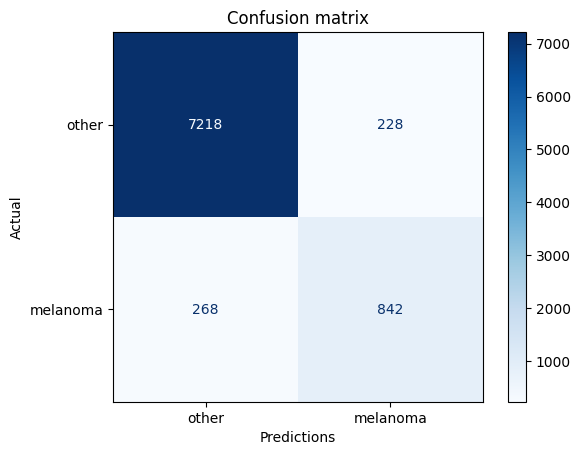

In [ ]:
predictions_array = []
test_labels_array = []
for images, labels in test_ds:
    predictions = best_ft_model.predict(images, verbose=0)
    predictions_array.extend(predictions)
    test_labels_array.extend(labels.numpy())
predictions_array = np.array(predictions_array)
test_labels_array = np.array(test_labels_array)

plot_confusion_matrix(test_labels_array, predictions_array, threshold=0.5)

## EfficientNetV2B0

! оновити визначення версії, моделі, індекс, базова модель, модель

### Transfer learning

In [ ]:
labels = ['tl-', 'ft-']
label = labels[0]
print(label, MODEL_NAME)

# створення та компіляція transfer learning моделі
tl_model = make_model(metrics=METRICS, model=model, output_bias=initial_bias)
model.summary(show_trainable=True)

tl- EfficientNetV2B0_04-07-19


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Layer (type)                        ┃ Output Shape                 ┃       Param # ┃ Traina… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━┩
│ input_layer_1 (InputLayer)          │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ lambda (Lambda)                     │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ efficientnetv2-b0 (Functional)      │ (None, 8, 8, 1280)           │     5,919,312 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ global_average_pooling2d            │ (None, 1280)                 │             0 │    -    │
│ (GlobalAveragePooling2D)            │                              │               │         │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ dropout (Dropout)                   │ (None, 1280)                 │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ full_con1 (Dense)                   │ (None, 128)                  │       163,968 │    Y    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ pred (Dense)                        │ (None, 1)                    │           129 │    Y    │
└─────────────────────────────────────┴──────────────────────────────┴───────────────┴─────────┘

 Total params: 6,083,409 (23.21 MB)

 Trainable params: 164,097 (641.00 KB)

 Non-trainable params: 5,919,312 (22.58 MB)

In [ ]:
metrics_logger = MetricsLogger(filepath=f"metrics_logs_{label}{MODEL_NAME}.csv")

callbacks_list = [EarlyStopping(monitor='val_accuracy', patience=6),
                  ModelCheckpoint(f'small-{label}{MODEL_NAME}.keras', monitor='val_loss', save_best_only=True),
                  metrics_logger,
                  # WandbMetricsLogger(),
                  # WandbModelCheckpoint(filepath=f"small-{label}{MODEL_NAME}_wandb.keras", monitor="val_loss")
]

epochs=20

In [ ]:
# EfficientNetV2B0
history = tl_model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs,
  callbacks=callbacks_list,
  class_weight=class_weights
)

Epoch 1/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 78s 101ms/step - accuracy: 0.9267 - auc: 0.9712 - fn: 272.7500 - fp: 215.0826 - loss: 0.1970 - prc: 0.9656 - precision: 0.9168 - recall: 0.8905 - tn: 4465.9834 - tp: 2806.0061 - val_accuracy: 0.8330 - val_auc: 0.9614 - val_fn: 335.0000 - val_fp: 5.0000 - val_loss: 0.3855 - val_prc: 0.9677 - val_precision: 0.9927 - val_recall: 0.6709 - val_tn: 1013.0000 - val_tp: 683.0000
Epoch 2/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 24s 48ms/step - accuracy: 0.9543 - auc: 0.9876 - fn: 206.7252 - fp: 138.7025 - loss: 0.1278 - prc: 0.9864 - precision: 0.9535 - recall: 0.9305 - tn: 4543.1343 - tp: 2869.4009 - val_accuracy: 0.8723 - val_auc: 0.9668 - val_fn: 248.0000 - val_fp: 12.0000 - val_loss: 0.2871 - val_prc: 0.9724 - val_precision: 0.9847 - val_recall: 0.7564 - val_tn: 1006.0000 - val_tp: 770.0000
Epoch 3/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 22s 46ms/step - accuracy: 0.9601 - auc: 0.9895 - fn: 180.6797 - fp: 135.2624 - loss: 0.1157 - prc: 0.9884 - precision: 0.9558 - reca

In [ ]:
from google.colab import files

df_basic = pd.DataFrame(history.history)
df_basic.to_csv(f"metrics_{label}{MODEL_NAME}.csv", index=False)

files.download(f'/content/metrics_logs_{label}{MODEL_NAME}.csv')
files.download(f'/content/small-{label}{MODEL_NAME}.keras')
files.download(f'/content/metrics_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

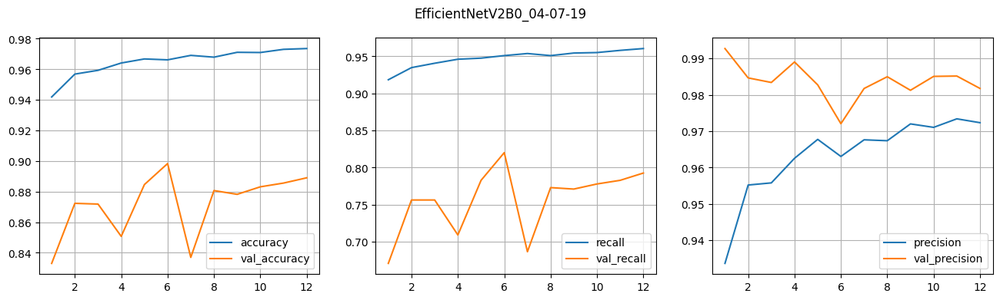

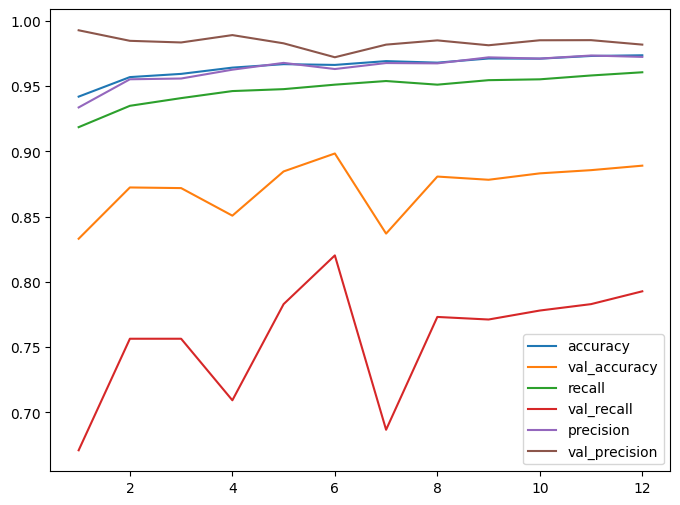

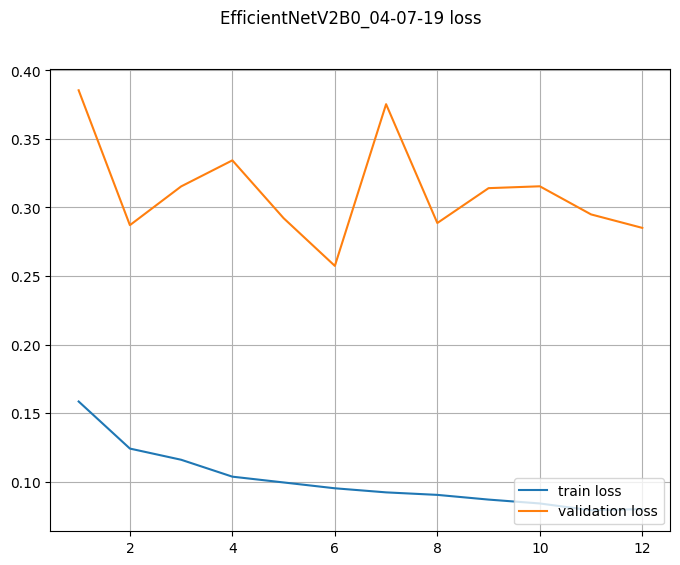

In [ ]:
plot_scores (df_basic, MODEL_NAME, ['accuracy', 'recall', 'precision'])
plot_loss(df_basic, MODEL_NAME)

In [ ]:
model_path = f"/content/small-tl-{MODEL_NAME}.keras"
best_tl_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})

best_tl_results = best_tl_model.evaluate(test_ds, verbose=1)

precision = best_tl_results[2]
recall = best_tl_results[3]
fbeta = fbeta_metric(precision, recall)
best_tl_results.append(fbeta)

268/268 ━━━━━━━━━━━━━━━━━━━━ 22s 56ms/step - accuracy: 0.9575 - auc: 0.9683 - fn: 102.0074 - fp: 81.1450 - loss: 0.1252 - prc: 0.9071 - precision: 0.8434 - recall: 0.8148 - tn: 3687.1487 - tp: 449.4312


In [ ]:
for metric, value in zip(["loss"] + [m.name for m in METRICS] + ["f1_beta"], best_tl_results):
  print(metric, ': ', value)
print()

loss :  0.12353289127349854
accuracy :  0.9594436883926392
precision :  0.8582159876823425
recall :  0.823423445224762
tp :  914.0
fp :  151.0
tn :  7295.0
fn :  196.0
auc :  0.9681494235992432
prc :  0.9128931760787964
f1_beta :  0.8301544275371364



In [ ]:
# Зберегти результат оцінки на тествому наборі
df_eval = pd.DataFrame({'Metric': ["loss"] + [m.name for m in METRICS] + ["f1_beta"], 'Value': best_tl_results})
df_eval.to_csv(f'evaluate_results_{label}{MODEL_NAME}.csv', index=False)
files.download(f'/content/evaluate_results_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Fine tuning

ft- EfficientNetV2B0_04-07-19


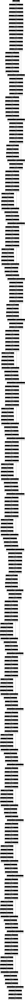

In [ ]:
labels = ['tl-', 'ft-']
label = labels[1]
print(label,  MODEL_NAME)

model_path = f"/content/small-tl-{MODEL_NAME}.keras"
best_tl_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})
# ! замінити назву шара:
base_model = best_tl_model.get_layer('efficientnetv2-b0')
plot_model(base_model, show_shapes=True)

In [ ]:
for layer in base_model.layers[-20:]:
  layer.trainable=True

for layer in base_model.layers[:-20]:
  layer.trainable=False

best_tl_model.summary(show_trainable=True)

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Layer (type)                        ┃ Output Shape                 ┃       Param # ┃ Traina… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━┩
│ input_layer_1 (InputLayer)          │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ lambda (Lambda)                     │ (None, 256, 256, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ efficientnetv2-b0 (Functional)      │ (None, 8, 8, 1280)           │     5,919,312 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ global_average_pooling2d            │ (None, 1280)                 │             0 │    -    │
│ (GlobalAveragePooling2D)            │                              │               │         │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ dropout (Dropout)                   │ (None, 1280)                 │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ full_con1 (Dense)                   │ (None, 128)                  │       163,968 │    Y    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ pred (Dense)                        │ (None, 1)                    │           129 │    Y    │
└─────────────────────────────────────┴──────────────────────────────┴───────────────┴─────────┘

 Total params: 6,411,605 (24.46 MB)

 Trainable params: 981,937 (3.75 MB)

 Non-trainable params: 5,101,472 (19.46 MB)

 Optimizer params: 328,196 (1.25 MB)

In [ ]:
metrics_logger = MetricsLogger(filepath=f"metrics_logs_{label}{MODEL_NAME}.csv")

best_tl_model.compile(
    optimizer=keras.optimizers.Adam(learning_rate=1e-5),
    loss=keras.losses.BinaryCrossentropy(),
    metrics=METRICS)

callbacks_list = [EarlyStopping(monitor='val_accuracy', patience=6),
                  ModelCheckpoint(f'small-{label}{MODEL_NAME}.keras', monitor='val_loss', save_best_only=True),
                  metrics_logger,
                  # WandbMetricsLogger(),
                  # WandbModelCheckpoint(filepath=f"small-{label}{MODEL_NAME}_wandb.keras", monitor="val_loss")
]

epochs=20

In [ ]:
# EfficientNetV2B0 fine tuning
history = best_tl_model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs,
  callbacks=callbacks_list,
  class_weight=class_weights
)

Epoch 1/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 74s 93ms/step - accuracy: 0.9298 - auc: 0.9755 - fn: 388.2417 - fp: 251.0661 - loss: 0.1575 - prc: 0.9735 - precision: 0.9384 - recall: 0.8952 - tn: 5444.1362 - tp: 3710.0723 - val_accuracy: 0.8590 - val_auc: 0.9664 - val_fn: 276.0000 - val_fp: 11.0000 - val_loss: 0.3591 - val_prc: 0.9718 - val_precision: 0.9854 - val_recall: 0.7289 - val_tn: 1007.0000 - val_tp: 742.0000
Epoch 2/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 24s 49ms/step - accuracy: 0.9544 - auc: 0.9872 - fn: 192.6178 - fp: 150.4318 - loss: 0.1316 - prc: 0.9837 - precision: 0.9468 - recall: 0.9370 - tn: 4540.4854 - tp: 2874.2788 - val_accuracy: 0.8556 - val_auc: 0.9678 - val_fn: 282.0000 - val_fp: 12.0000 - val_loss: 0.3690 - val_prc: 0.9731 - val_precision: 0.9840 - val_recall: 0.7230 - val_tn: 1006.0000 - val_tp: 736.0000
Epoch 3/20
483/483 ━━━━━━━━━━━━━━━━━━━━ 24s 50ms/step - accuracy: 0.9592 - auc: 0.9894 - fn: 185.6632 - fp: 132.5517 - loss: 0.1198 - prc: 0.9866 - precision: 0.9572 - reca

In [ ]:
# from google.colab import files

df_basic = pd.DataFrame(history.history)
df_basic.to_csv(f"metrics_{label}{MODEL_NAME}.csv", index=False)

files.download(f'/content/metrics_logs_{label}{MODEL_NAME}.csv')
files.download(f'/content/small-{label}{MODEL_NAME}.keras')
files.download(f'/content/metrics_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

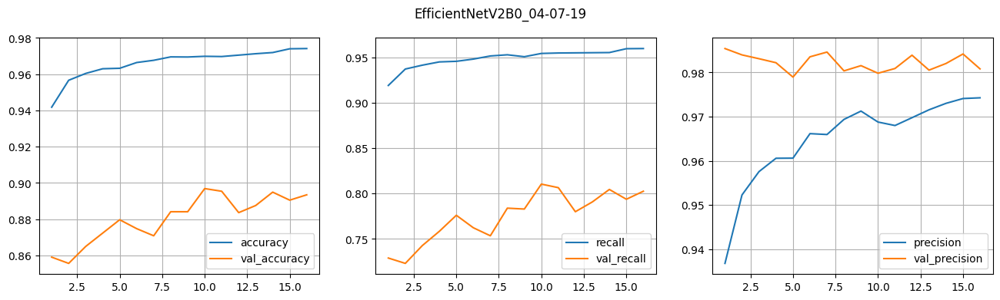

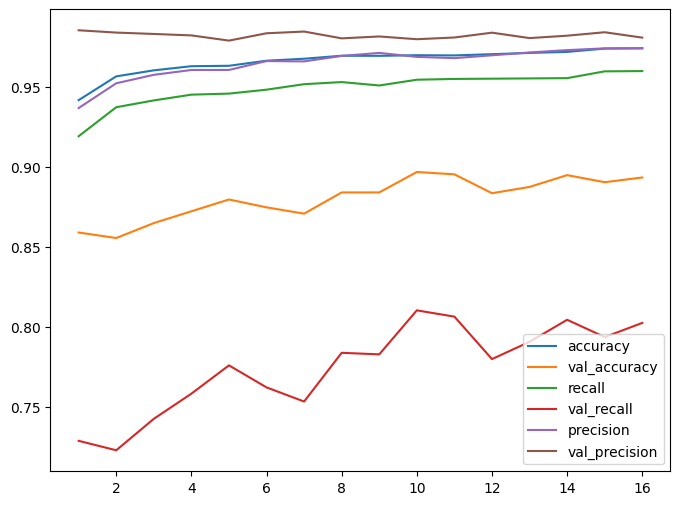

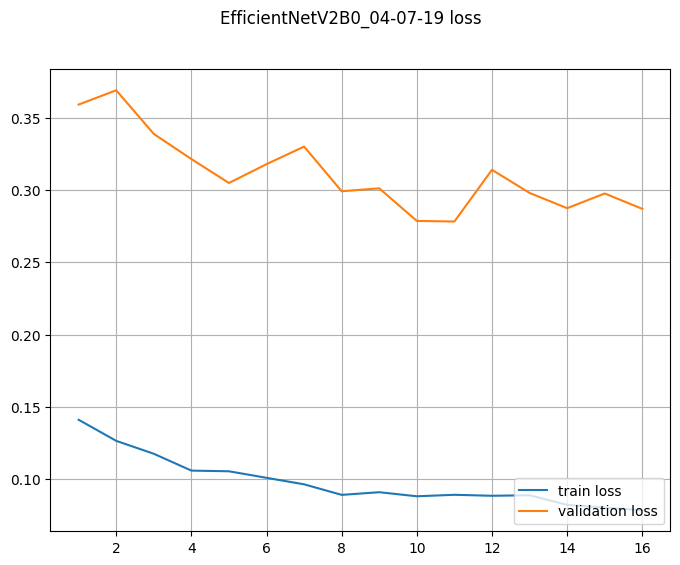

In [ ]:
plot_scores (df_basic, MODEL_NAME, ['accuracy', 'recall', 'precision'])
plot_loss(df_basic, MODEL_NAME)

In [ ]:
# load best model after fine tuning
model_path = f"/content/small-ft-{MODEL_NAME}.keras"
best_ft_model = keras.models.load_model(model_path, custom_objects={"preprocess_input": preprocess_input})

best_ft_results = best_ft_model.evaluate(test_ds, verbose=1)

precision = best_ft_results[2]
recall = best_ft_results[3]
fbeta = fbeta_metric(precision, recall)
best_ft_results.append(fbeta)

268/268 ━━━━━━━━━━━━━━━━━━━━ 20s 50ms/step - accuracy: 0.9646 - auc: 0.9732 - fn: 105.8996 - fp: 46.0297 - loss: 0.1072 - prc: 0.9188 - precision: 0.9058 - recall: 0.8069 - tn: 3722.0781 - tp: 445.7249


In [ ]:
for metric, value in zip(["loss"] + [m.name for m in METRICS] + ["f1_beta"], best_ft_results):
  print(metric, ': ', value)
print()

loss :  0.10486175864934921
accuracy :  0.9661056399345398
precision :  0.913306474685669
recall :  0.816216230392456
tp :  906.0
fp :  86.0
tn :  7360.0
fn :  204.0
auc :  0.9733328819274902
prc :  0.924095630645752
f1_beta :  0.8339469965407189



In [ ]:
# Зберегти результат оцінки на тествому наборі
df_eval = pd.DataFrame({'Metric': ["loss"] + [m.name for m in METRICS] + ["f1_beta"], 'Value': best_ft_results})
df_eval.to_csv(f'evaluate_results_{label}{MODEL_NAME}.csv', index=False)
files.download(f'/content/evaluate_results_{label}{MODEL_NAME}.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

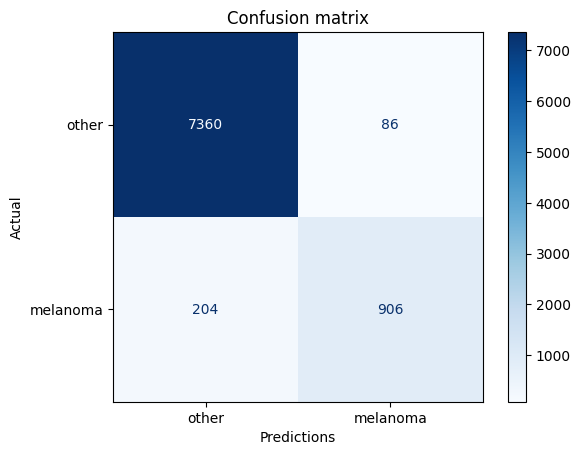

In [ ]:
predictions_array = []
test_labels_array = []
for images, labels in test_ds:
    predictions = best_ft_model.predict(images, verbose=0)
    predictions_array.extend(predictions)
    test_labels_array.extend(labels.numpy())
predictions_array = np.array(predictions_array)
test_labels_array = np.array(test_labels_array)

plot_confusion_matrix(test_labels_array, predictions_array, threshold=0.5)